# 1) Read the file

In [1]:
from google.colab import drive
drive.mount('/content/gdrive/', force_remount=True)

Mounted at /content/gdrive/


Set CUDA on colab

In [2]:
!pip install -U mxnet-cu101

     |████████████████████████████████| 356.7 MB 28 kB/s 
  Attempting uninstall: graphviz
    Found existing installation: graphviz 0.10.1
    Uninstalling graphviz-0.10.1:
      Successfully uninstalled graphviz-0.10.1


In [3]:
!pip install mne

     |████████████████████████████████| 7.4 MB 7.1 MB/s 


In [4]:
!nvidia-smi

Sun Nov 28 10:54:40 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    29W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [5]:
%matplotlib inline
import numpy as np
import pandas as pd
from scipy import signal
import mne
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
from torch.utils.data import TensorDataset
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter

import copy
import time
import pickle
import statistics
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from tqdm import tqdm
from IPython.display import clear_output
warnings.filterwarnings("ignore")

import sklearn
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import make_scorer
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

In [6]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [7]:
file_1 = '/content/gdrive/MyDrive/Datasets/raw_data/1_1_20180804.cnt'

In [8]:
raw = mne.io.read_raw_cnt(file_1, data_format= 'int32', preload = True)

Reading 0 ... 3378359  =      0.000 ...  3378.359 secs...


In [9]:
mne.channels.find_layout(raw.info)

<Layout | EEG - Channels: FP1, FPZ, FP2 ...>

## Check the montage layout

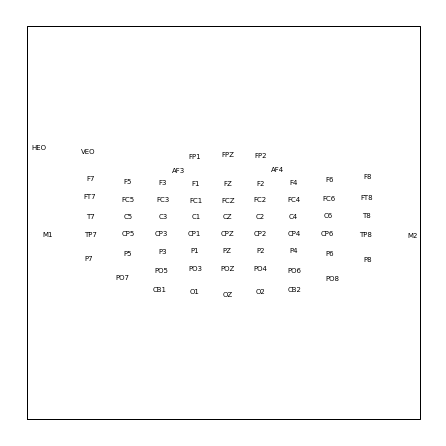

Figure(432x432)


In [10]:
layout_from_raw = mne.channels.make_eeg_layout(raw.info)

print(layout_from_raw.plot())

# 2) Basic exploration

In [11]:
raw

<RawCNT | 1_1_20180804.cnt, 66 x 3378360 (3378.4 s), ~1.66 GB, data loaded>

In [12]:
# check channel names
ch_names = raw.ch_names
print(ch_names)
print(len(ch_names))
print('\n')

['FP1', 'FPZ', 'FP2', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'FZ', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'CZ', 'C2', 'C4', 'C6', 'T8', 'M1', 'TP7', 'CP5', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'CP6', 'TP8', 'M2', 'P7', 'P5', 'P3', 'P1', 'PZ', 'P2', 'P4', 'P6', 'P8', 'PO7', 'PO5', 'PO3', 'POZ', 'PO4', 'PO6', 'PO8', 'CB1', 'O1', 'OZ', 'O2', 'CB2', 'VEO', 'HEO']
66




In [13]:
# # drop non-used channels
useless_ch = ['M1', 'M2', 'VEO', 'HEO', 'CB1', 'CB2']
raw.drop_channels(useless_ch)
new_ch = raw.ch_names
print(new_ch)
print(len(new_ch))
print('\n')

['FP1', 'FPZ', 'FP2', 'AF3', 'AF4', 'F7', 'F5', 'F3', 'F1', 'FZ', 'F2', 'F4', 'F6', 'F8', 'FT7', 'FC5', 'FC3', 'FC1', 'FCZ', 'FC2', 'FC4', 'FC6', 'FT8', 'T7', 'C5', 'C3', 'C1', 'CZ', 'C2', 'C4', 'C6', 'T8', 'TP7', 'CP5', 'CP3', 'CP1', 'CPZ', 'CP2', 'CP4', 'CP6', 'TP8', 'P7', 'P5', 'P3', 'P1', 'PZ', 'P2', 'P4', 'P6', 'P8', 'PO7', 'PO5', 'PO3', 'POZ', 'PO4', 'PO6', 'PO8', 'O1', 'OZ', 'O2']
60




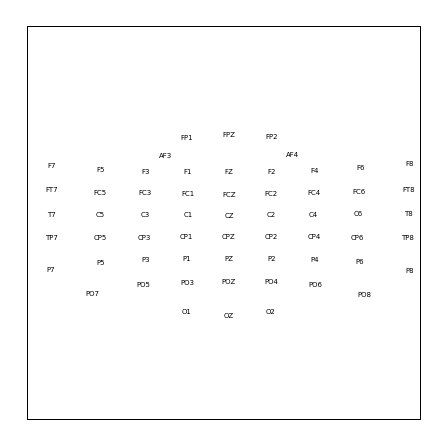

Figure(432x432)


In [14]:
layout_from_raw = mne.channels.make_eeg_layout(raw.info)
print(layout_from_raw.plot())

## Resample the signal frequency to 200

In [15]:
raw =  raw.resample(sfreq= 200)

In [16]:
raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

In [17]:
raw.get_data().shape

(60, 675672)

Using matplotlib as 2D backend.


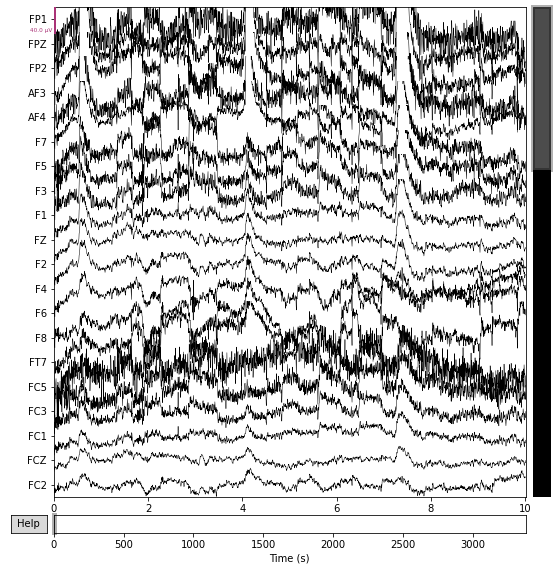

Figure(576x576)


In [18]:
print(raw.plot())

## Plot Power Spectral Density (psd)

Effective window size : 10.240 (s)


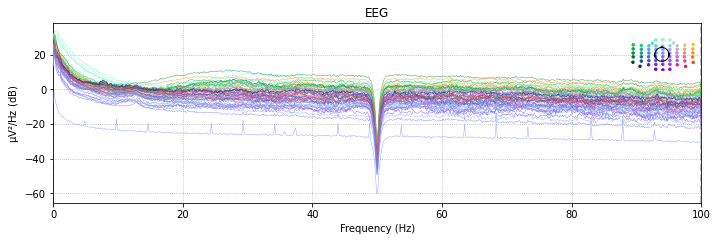

Figure(720x252)


In [19]:
print(raw.plot_psd())

As we can see from the chart, the power line frequency at 50 Hz has been removed

## Adjust the montage to standard_1020 layout

In [20]:
new_raw = raw.copy()
montage = mne.channels.make_standard_montage(kind = "standard_1020")
new_raw.set_montage(montage, match_case= False)

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

Effective window size : 10.240 (s)


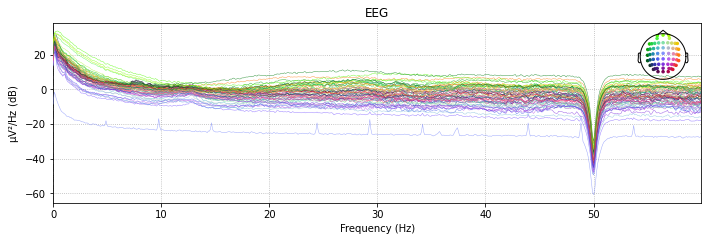

Figure(720x252)


In [21]:
print(new_raw.plot_psd(spatial_colors=True, average=False, fmax=60))

In [22]:
new_raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

## Apply filter to extract signal frequency from 1 - 40

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 1 - 40 Hz

IIR filter parameters
---------------------
Butterworth bandpass zero-phase (two-pass forward and reverse) non-causal filter:
- Filter order 16 (effective, after forward-backward)
- Cutoffs at 1.00, 40.00 Hz: -6.02, -6.02 dB

Effective window size : 10.240 (s)


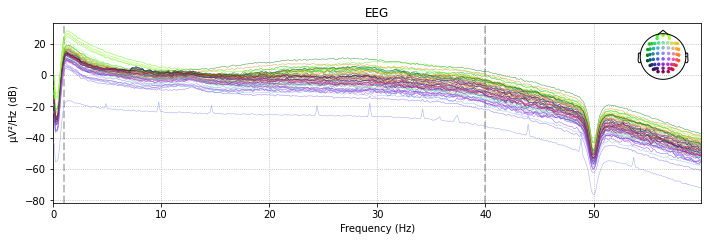

Figure(720x252)


In [23]:
new_raw.filter(1, 40, method='iir')
print(new_raw.plot_psd(fmax= 60))


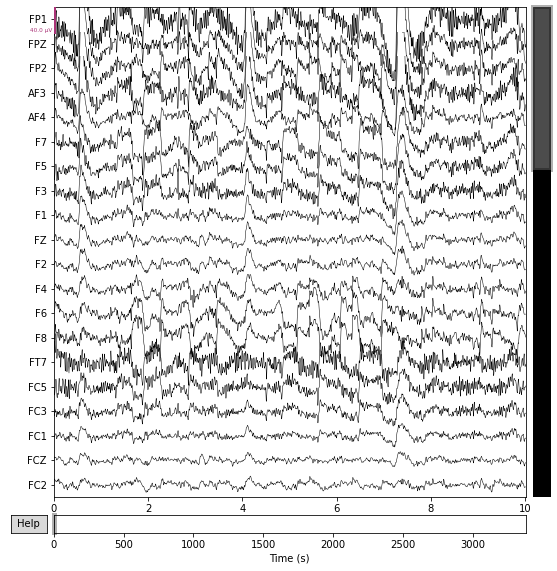

Figure(576x576)


In [24]:
print(new_raw.plot())

In [25]:
new_raw.info

<Info | 9 non-empty values
 bads: []
 ch_names: FP1, FPZ, FP2, AF3, AF4, F7, F5, F3, F1, FZ, F2, F4, F6, F8, ...
 chs: 60 EEG
 custom_ref_applied: False
 dig: 63 items (3 Cardinal, 60 EEG)
 highpass: 1.0 Hz
 lowpass: 40.0 Hz
 meas_date: 2018-04-08 11:35:05 UTC
 nchan: 60
 projs: []
 sfreq: 200.0 Hz
 subject_info: 5 items (dict)
>

## ICA (Try but not use)

In [26]:
#filtering to remove slow drifts; also make copy of raw for later signal reconstruction
from mne.preprocessing import ICA

In [27]:
# set up and fit the ICA
ica = ICA(n_components=16, random_state=32)
ica.fit(new_raw)

Fitting ICA to data using 60 channels (please be patient, this may take a while)
Selecting by number: 16 components
Fitting ICA took 28.8s.


Method,fastica
Fit,53 iterations on raw data (675672 samples)
ICA components,16
Explained variance,96.6 %
Available PCA components,60
Channel types,eeg
ICA components marked for exclusion,—


Creating RawArray with float64 data, n_channels=16, n_times=675672
    Range : 0 ... 675671 =      0.000 ...  3378.355 secs
Ready.


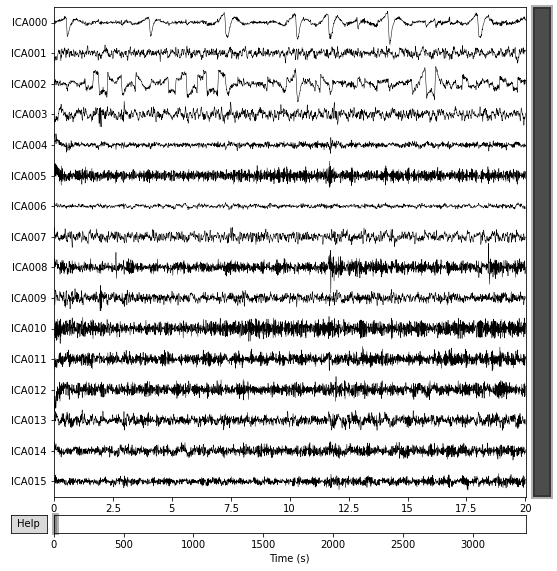

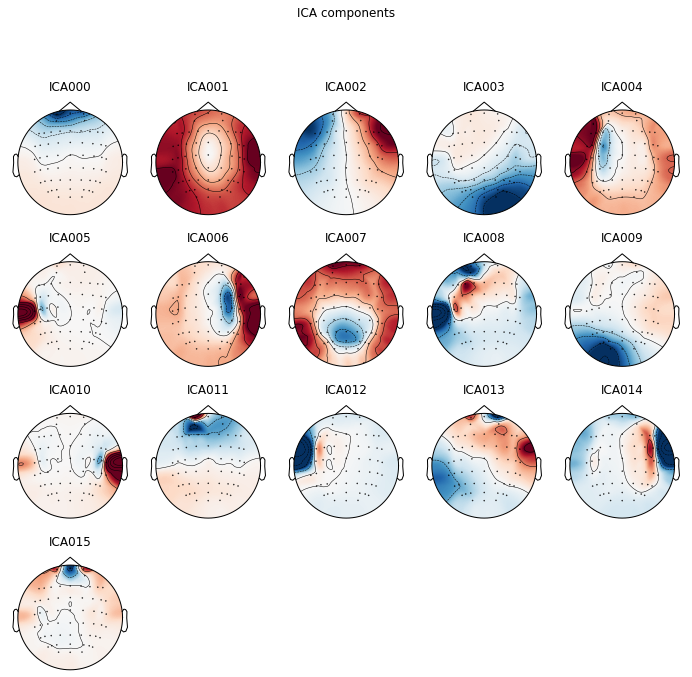

[<MNEFigure size 702x696.24 with 16 Axes>]

In [28]:
ica.plot_sources(new_raw)
ica.plot_components()

Applying ICA to Raw instance
    Transforming to ICA space (16 components)
    Zeroing out 2 ICA components
    Projecting back using 60 PCA components


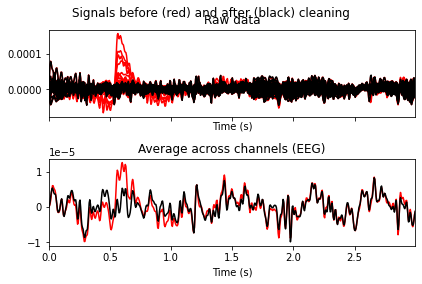

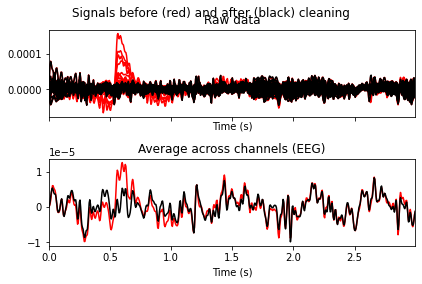

In [29]:
#test excluding 0, 1 component
ica.plot_overlay(new_raw, exclude = [0,11], picks='eeg')

Applying ICA to Raw instance
    Transforming to ICA space (16 components)
    Zeroing out 2 ICA components
    Projecting back using 60 PCA components


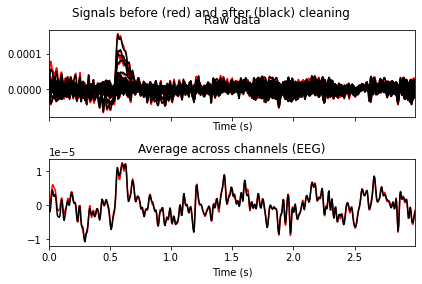

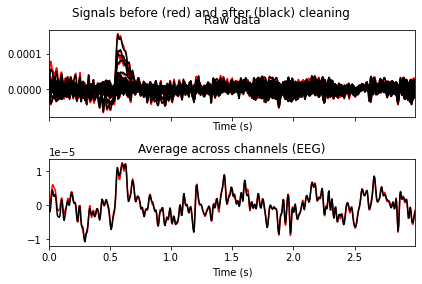

In [30]:
#test excluding 0, 1 component
ica.plot_overlay(new_raw, exclude = [11,12], picks='eeg')

Applying ICA to Raw instance
    Transforming to ICA space (16 components)
    Zeroing out 2 ICA components
    Projecting back using 60 PCA components


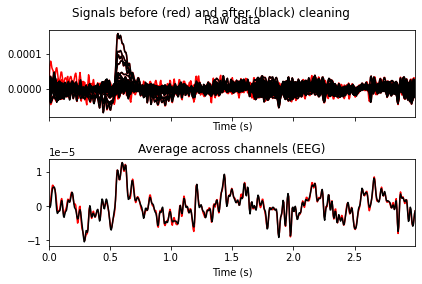

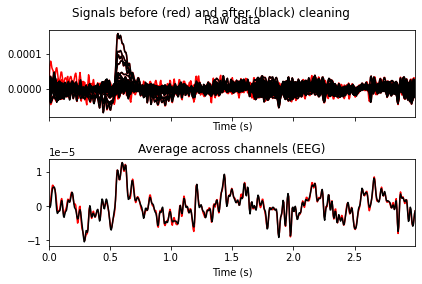

In [31]:
#test excluding 0, 1 component
ica.plot_overlay(new_raw, exclude = [5,10], picks='eeg')

Applying ICA to Raw instance
    Transforming to ICA space (16 components)
    Zeroing out 4 ICA components
    Projecting back using 60 PCA components


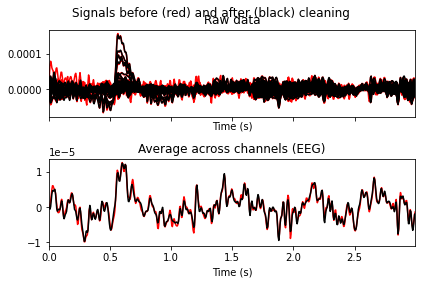

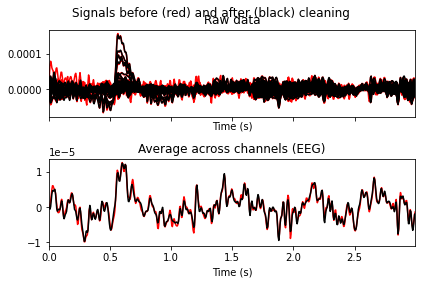

In [32]:
#test excluding 0, 1 component
ica.plot_overlay(new_raw, exclude = [5,9,10,13], picks='eeg')

Applying ICA to Raw instance
    Transforming to ICA space (16 components)
    Zeroing out 4 ICA components
    Projecting back using 60 PCA components


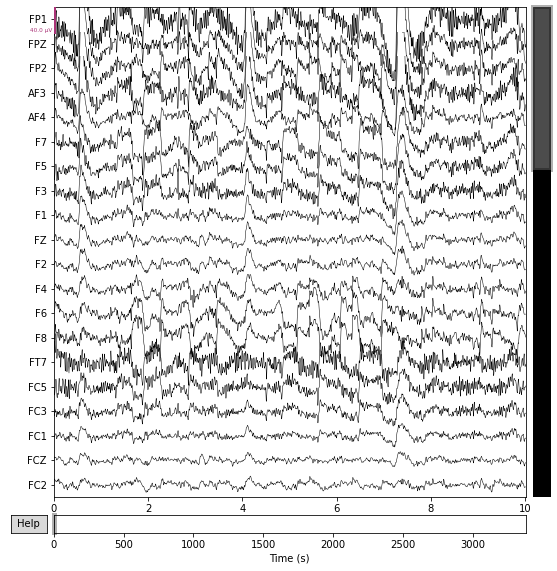

Figure(576x576)


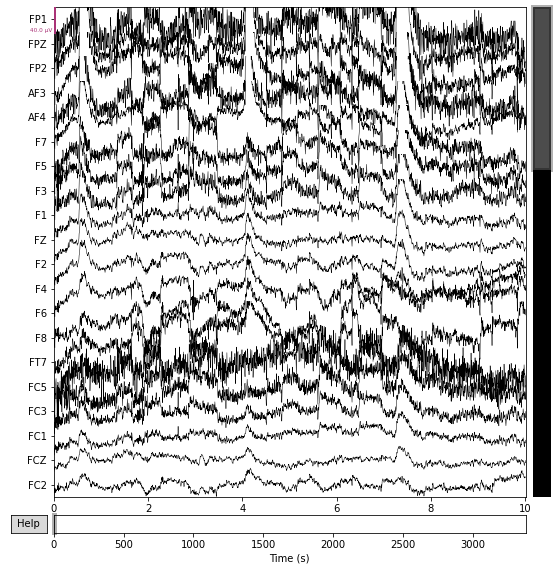

Figure(576x576)


In [33]:
original_raw = new_raw.copy()
ica.exclude = [5, 9,10,13]
ica.apply(new_raw)

print(original_raw.plot())
print(raw.plot())

In [34]:
new_raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

In [35]:
from mne import Epochs, find_events

In [36]:
raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

In [37]:
 mne.make_fixed_length_events(raw, start=2, stop=500, duration=10)

array([[  400,     0,     1],
       [ 2400,     0,     1],
       [ 4400,     0,     1],
       [ 6400,     0,     1],
       [ 8400,     0,     1],
       [10400,     0,     1],
       [12400,     0,     1],
       [14400,     0,     1],
       [16400,     0,     1],
       [18400,     0,     1],
       [20400,     0,     1],
       [22400,     0,     1],
       [24400,     0,     1],
       [26400,     0,     1],
       [28400,     0,     1],
       [30400,     0,     1],
       [32400,     0,     1],
       [34400,     0,     1],
       [36400,     0,     1],
       [38400,     0,     1],
       [40400,     0,     1],
       [42400,     0,     1],
       [44400,     0,     1],
       [46400,     0,     1],
       [48400,     0,     1],
       [50400,     0,     1],
       [52400,     0,     1],
       [54400,     0,     1],
       [56400,     0,     1],
       [58400,     0,     1],
       [60400,     0,     1],
       [62400,     0,     1],
       [64400,     0,     1],
       [66

In [38]:
raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

In [39]:
new_raw

<RawCNT | 1_1_20180804.cnt, 60 x 675672 (3378.4 s), ~309.4 MB, data loaded>

In [40]:
new_raw.get_data().shape == raw.get_data().shape

True

In [41]:
print((102-30) * 200)

14400


In [42]:
print(228-132)

96


## Event setup

In [43]:
data_matrix = raw.copy()
type(data_matrix)

mne.io.cnt.cnt.RawCNT

In [44]:
# with file "trial_start_end_timestamp.txt", you can split the data into different trials
# start_second = [30, 353, 478, 674, 825, 908, 1200, 1346, 1451, 1711, 2055, 2307, 2457, 2726, 2888]
# end_second = [321, 418, 643, 764, 877, 1147, 1284, 1418, 1679, 1996, 2275, 2425, 2664, 2857, 3066]

###########################################################
### Notice: we did not filt the orignal signal here #######
### you may need to filt the data before other process ####
### To filt the signal, please refer to MNE documents #####
###########################################################
start_second= [30, 132, 287, 555, 773, 982, 1271, 1628, 1730, 2025, 2227, 2435, 2667, 2932, 3204]
end_second= [102, 228, 524, 742, 920, 1240, 1568, 1697, 1994, 2166, 2401, 2607, 2901, 3172, 3359]
sample_freq = 200

data_trial_1 = data_matrix[:, start_second[0]*sample_freq : end_second[0]*sample_freq]
data_trial_2 = data_matrix[:, start_second[1]*sample_freq : end_second[1]*sample_freq]
data_trial_3 = data_matrix[:, start_second[2]*sample_freq : end_second[2]*sample_freq]
data_trial_4 = data_matrix[:, start_second[3]*sample_freq : end_second[3]*sample_freq]
data_trial_5 = data_matrix[:, start_second[4]*sample_freq : end_second[4]*sample_freq]
data_trial_6 = data_matrix[:, start_second[5]*sample_freq : end_second[5]*sample_freq]
data_trial_7 = data_matrix[:, start_second[6]*sample_freq : end_second[6]*sample_freq]
data_trial_8 = data_matrix[:, start_second[7]*sample_freq : end_second[7]*sample_freq]
data_trial_9 = data_matrix[:, start_second[8]*sample_freq : end_second[8]*sample_freq]
data_trial_10 = data_matrix[:, start_second[9]*sample_freq : end_second[9]*sample_freq]
data_trial_11= data_matrix[:, start_second[10]*sample_freq : end_second[10]*sample_freq]
data_trial_12 = data_matrix[:, start_second[11]*sample_freq : end_second[11]*sample_freq]
data_trial_13 = data_matrix[:, start_second[12]*sample_freq : end_second[12]*sample_freq]
data_trial_14 = data_matrix[:, start_second[13]*sample_freq : end_second[13]*sample_freq]
data_trial_15 = data_matrix[:, start_second[14]*sample_freq : end_second[14]*sample_freq]

# print(data_trial_1.shape)
# print(data_trial_2.shape)
# print(data_trial_3.shape)
# print(data_trial_4.shape)
# print(data_trial_5.shape)
# print(data_trial_6.shape)
# print(data_trial_7.shape)
# print(data_trial_8.shape)
# print(data_trial_9.shape)
# print(data_trial_10.shape)
# print(data_trial_11.shape)
# print(data_trial_12.shape)
# print(data_trial_13.shape)
# print(data_trial_14.shape)
# print(data_trial_15.shape)

In [45]:
ch_names = raw.ch_names

In [46]:
#mne.time_frequency.stft(data_trial_1[0], wsize=4 ).shape

In [47]:
import mne
from mne import create_info
ch_types = ['eeg'] * 60
event1 = mne.io.RawArray(data_trial_1[0], info = create_info(ch_names=ch_names, ch_types='eeg', sfreq=sample_freq))
event1

Creating RawArray with float64 data, n_channels=60, n_times=14400
    Range : 0 ... 14399 =      0.000 ...    71.995 secs
Ready.


<RawArray | 60 x 14400 (72.0 s), ~6.7 MB, data loaded>

In [48]:
event = mne.make_fixed_length_epochs(event1, duration =4.0)
event

Not setting metadata
Not setting metadata
18 matching events found
No baseline correction applied
0 projection items activated


Number of events,18
Events,1: 18
Time range,0.000 – 3.995 sec
Baseline,off


Effective window size : 10.240 (s)


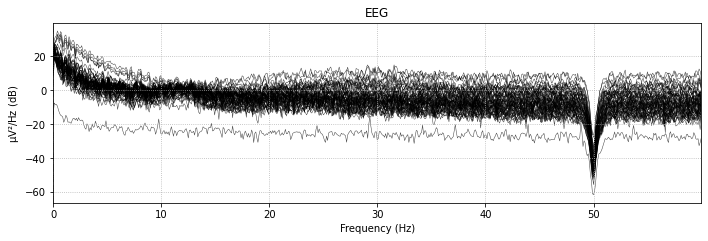

Figure(720x252)


In [49]:
print(event1.plot_psd(fmax= 60))

In [50]:
test = event.get_data()
type(test)

Loading data for 18 events and 800 original time points ...
0 bad epochs dropped


numpy.ndarray

Loading data for 18 events and 800 original time points ...
Not setting metadata
Not setting metadata
18 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped
combining channels using "gfp"


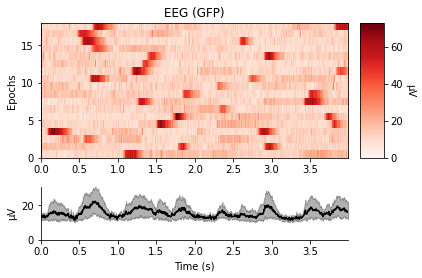

[<Figure size 432x288 with 3 Axes>]

In [51]:
event.plot_image()

Loading data for 18 events and 800 original time points ...
Loading data for 18 events and 800 original time points ...


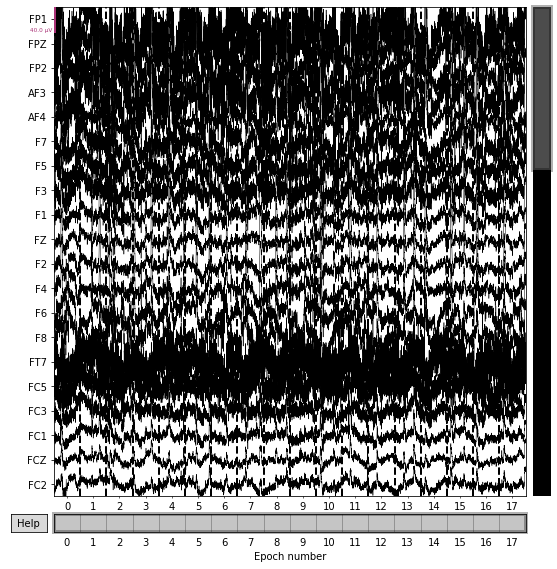

Figure(576x576)


In [52]:
print(event.plot())

In [53]:
event.get_data().shape
#800 comes from window size of 4 seconds * 200 sampling frequency

Loading data for 18 events and 800 original time points ...


(18, 60, 800)

In [54]:
event.get_data()[0]

Loading data for 18 events and 800 original time points ...


array([[-2.51139187e-05, -1.00236502e-05,  1.87302427e-05, ...,
         3.02570040e-05,  3.72916125e-05,  5.15004980e-05],
       [-2.56509993e-05, -3.25891290e-05, -1.26571515e-05, ...,
         1.38491588e-05,  3.95333581e-05,  3.30081845e-05],
       [-2.56336370e-05, -1.67489267e-05, -1.45459047e-05, ...,
         7.72759161e-06,  2.27769718e-05,  1.54642122e-05],
       ...,
       [ 1.23180568e-06,  9.71758962e-07,  8.88918592e-08, ...,
         1.18259718e-06,  2.51419510e-06, -6.63280387e-06],
       [-1.43610627e-05, -9.35324351e-06, -1.31784423e-05, ...,
         1.01009116e-05,  6.48829166e-06, -1.32130072e-06],
       [-5.15352057e-06,  2.78461020e-06,  9.22883437e-07, ...,
        -5.35078182e-06, -5.30226984e-06, -1.03410197e-05]])

In [55]:
result = mne.time_frequency.csd_array_fourier(event.get_data(), sfreq = 200)

Loading data for 18 events and 800 original time points ...
Computing cross-spectral density from epochs...


  0%|          | CSD epoch blocks : 0/18 [00:00<?,       ?it/s]

[done]


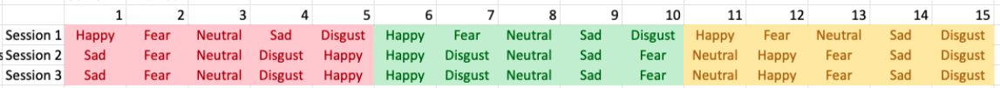

In [57]:
X = event.get_data()
y = event.events[:, -1]

print(X.shape)
print(y.shape)

Loading data for 18 events and 800 original time points ...
(18, 60, 800)
(18,)


In [58]:
data = X
label = y
print(data.shape)

(18, 60, 800)


(54000, 16)


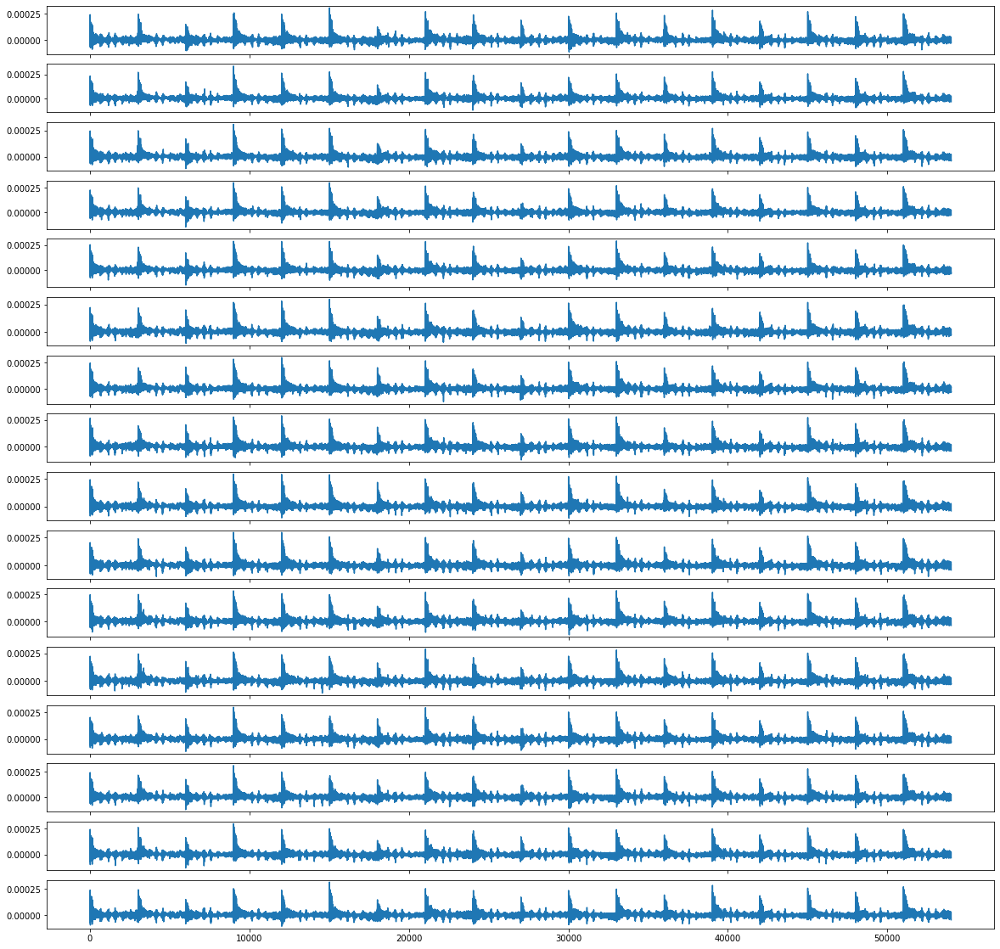

In [59]:
# Plot
data = X.reshape(-1,16)     # (-1,62)
print(data.shape)
fig, ax = plt.subplots(16,1,figsize=(20,20),sharex=True)

for i in range(data.shape[1]):
    ax[i].plot(range(data.shape[0]),data[:,i])

# 3) Download the bundled dataset

In [7]:
# check the version of these modules
print(np.__version__)
print(pickle.format_version)

1.19.5
4.0


In [8]:
data_npz = np.load('/content/gdrive/MyDrive/Datasets/preprocessed_data/1_123.npz')
print(data_npz.files)

['data', 'label']


## Train and test on the first SVM model

In [9]:
data = pickle.loads(data_npz['data'])
label = pickle.loads(data_npz['label'])

In [10]:
data

{0: array([[11.08252158,  8.91598993,  7.89408803, ...,  7.07195532,
          5.65708081,  4.36150606],
        [11.08181639,  8.91510401,  7.89364634, ...,  7.07177633,
          5.6569868 ,  4.36162375],
        [11.08113882,  8.91424457,  7.89311581, ...,  7.07146188,
          5.65674597,  4.36177956],
        ...,
        [11.09093681,  8.90651219,  7.88062322, ...,  7.05494398,
          5.64746577,  4.36830008],
        [11.09181965,  8.90597236,  7.87993625, ...,  7.05439539,
          5.64685332,  4.36912144],
        [11.09237631,  8.90556688,  7.87957235, ...,  7.05379577,
          5.64648296,  4.36975357]]),
 1: array([[10.5399661 ,  8.72896013,  7.56788644, ...,  6.64791569,
          5.35431435,  4.0177257 ],
        [10.53897522,  8.72844536,  7.56761172, ...,  6.64782481,
          5.35430551,  4.01779672],
        [10.53676455,  8.72737774,  7.5674892 , ...,  6.64798877,
          5.35445815,  4.01788296],
        ...,
        [10.52582223,  8.72269758,  7.57685102, 

In [11]:
print(data.keys())
print(label.keys())

dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44])
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44])


In [71]:
# As we can see, there are 45 keys in both 'data' and 'label'.
# Each participant took part in our experiments for 3 sessions, and he/she watched 15 movie clips (i.e. 15 trials) during each session.
# Therefore, we could extract 3 * 15 = 45 feature matrices.

# The key indexes [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] belong to Session 1.
# The key indexes [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29] belong to Session 2.
# The key indexes [30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44] belong to Session 3.

# We will print the emotion labels for each trial.
label_dict = {0:'Disgust', 1:'Fear', 2:'Sad', 3:'Neutral', 4:'Happy'}
for i in range(45):
    print('Session {} -- Trial {} -- EmotionLabel : {}'.format(i//15+1, i%15+1, label_dict[label[i][0]]))

Session 1 -- Trial 1 -- EmotionLabel : Happy
Session 1 -- Trial 2 -- EmotionLabel : Fear
Session 1 -- Trial 3 -- EmotionLabel : Neutral
Session 1 -- Trial 4 -- EmotionLabel : Sad
Session 1 -- Trial 5 -- EmotionLabel : Disgust
Session 1 -- Trial 6 -- EmotionLabel : Happy
Session 1 -- Trial 7 -- EmotionLabel : Fear
Session 1 -- Trial 8 -- EmotionLabel : Neutral
Session 1 -- Trial 9 -- EmotionLabel : Sad
Session 1 -- Trial 10 -- EmotionLabel : Disgust
Session 1 -- Trial 11 -- EmotionLabel : Happy
Session 1 -- Trial 12 -- EmotionLabel : Fear
Session 1 -- Trial 13 -- EmotionLabel : Neutral
Session 1 -- Trial 14 -- EmotionLabel : Sad
Session 1 -- Trial 15 -- EmotionLabel : Disgust
Session 2 -- Trial 1 -- EmotionLabel : Sad
Session 2 -- Trial 2 -- EmotionLabel : Fear
Session 2 -- Trial 3 -- EmotionLabel : Neutral
Session 2 -- Trial 4 -- EmotionLabel : Disgust
Session 2 -- Trial 5 -- EmotionLabel : Happy
Session 2 -- Trial 6 -- EmotionLabel : Happy
Session 2 -- Trial 7 -- EmotionLabel : Disgus

In [72]:
#Number of trial for each participant (3 sessions, each session has 15 trials)
len(data.keys())

45

In [74]:
# X = 18 (Number of event in trial 0)
# y = 310 (Number of electrode from 5 frequency bands, each band has 62 channels)
data[0].shape

(18, 310)

In [75]:
## Training
ses1_X_train = data[0]
ses1_y_train = label[0]
for session in range(1,  10):
    ses1_X_train = np.vstack((ses1_X_train, data[session] ))
    ses1_y_train = np.concatenate((ses1_y_train, label[session]), axis = 0)

print(ses1_X_train.shape)
print(ses1_y_train.shape)

(439, 310)
(439,)


In [76]:
## Testing
ses1_X_test = data[10]
ses1_y_test = label[10]
for session in range(11,  15):
    ses1_X_test = np.vstack((ses1_X_test, data[session] ))
    ses1_y_test = np.concatenate((ses1_y_test, label[session]), axis = 0)

print(ses1_X_test.shape)
print(ses1_y_test.shape)

(242, 310)
(242,)


In [78]:
model = SVC(C= 1, kernel= 'linear', degree= 3)

In [79]:
model.fit(ses1_X_train, ses1_y_train)

SVC(C=1, kernel='linear')

In [80]:
result = model.predict(ses1_X_test)

In [81]:
print(classification_report(y_pred =result, y_true= ses1_y_test ))

              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00        38
         1.0       0.00      0.00      0.00        43
         2.0       0.43      1.00      0.60        60
         3.0       1.00      1.00      1.00        58
         4.0       1.00      1.00      1.00        43

    accuracy                           0.67       242
   macro avg       0.49      0.60      0.52       242
weighted avg       0.52      0.67      0.57       242



## Individual-dependent of participant 1

In [82]:
# The key indexes [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14] belong to Session 1.
# The key indexes [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29] belong to Session 2.
# The key indexes [30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44] belong to Session 3.

In [83]:
np.vstack((data[0], data[1], data[2])).shape

(101, 310)

In [84]:
x = []
x = np.vstack((data[0], data[1], data[2]))

In [85]:
data[0].shape

(18, 310)

In [86]:
train_start_stop_1 = (0, 9)
train_start_stop_2 = (15, 24)
train_start_stop_3 = (30, 39)

test_start_stop_1 = (10, 15)
test_start_stop_2 = (25, 29)
test_start_stop_3 = (40, 44)

train_data_s1 = []
train_data_s2 = []
train_data_s3 = []

train_data_s1 = []
train_data_s2 = []
train_data_s3 = []

test_data_s1 = []
test_data_s2 = []
test_data_s3 = []

count = 0
for clips in range(train_start_stop_1[1] + 1):
    
    if len(train_data_s1) == 0:
        train_data_s1 = data[clips]
        test_data_s1  = label[clips]
        count += 1
        # print(train_data_s1.shape)
    else:
        train_data_s1 = np.vstack((train_data_s1, data[clips]))
        test_data_s1  = np.concatenate((test_data_s1, label[clips]))
        count += 1
        # print(train_data_s1.shape)

    assert train_data_s1.shape[0] == len(test_data_s1)
assert count == 10 

count = 0
for clips in range(train_start_stop_2[0], train_start_stop_2[1] + 1):
    if len(train_data_s2) == 0:
        train_data_s2 = data[clips]
        test_data_s2  = label[clips]
        count += 1
       
    else:
        train_data_s2 = np.vstack((train_data_s2, data[clips]))
        test_data_s2  = np.concatenate((test_data_s2, label[clips]))
        count += 1

    assert train_data_s2.shape[0] == len(test_data_s2)
assert count == 10  

count = 0
for clips in range(train_start_stop_3[0], train_start_stop_3[1] + 1):
    if len(train_data_s3) == 0:
        train_data_s3 = data[clips]
        test_data_s3  = label[clips]
        count += 1

    else:
        train_data_s3 = np.vstack((train_data_s3, data[clips]))
        test_data_s3  = np.concatenate((test_data_s3, label[clips]))
        count += 1

    assert train_data_s2.shape[0] == len(test_data_s2)
assert count == 10      

TRAIN_1 = [train_data_s1, train_data_s2, train_data_s3]
TEST_1  = [test_data_s1, test_data_s2, test_data_s3]

print(train_data_s1.shape)
print(train_data_s2.shape)
print(train_data_s3.shape)

(439, 310)
(370, 310)
(390, 310)


In [87]:
train_start_stop_1 = (0, 9)
train_start_stop_2 = (15, 24)
train_start_stop_3 = (30, 39)

test_start_stop_1 = (10, 14)
test_start_stop_2 = (25, 29)
test_start_stop_3 = (40, 44)

train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]

## Prepare Xtrain, ytrain for participant 1

In [88]:
X_train = []
y_train = []

X_test = []
y_test = []

## TRAIN
for session in range(3):
    count = 0
    Xtrain_data = []
    ytrain_data = []

    for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
        
        if len(Xtrain_data) == 0:
            Xtrain_data = data[clips]
            Ytrain_data  = label[clips]
            count += 1
            
        else:
            Xtrain_data = np.vstack((Xtrain_data, data[clips]))
            Ytrain_data = np.concatenate((Ytrain_data, label[clips]))
            count += 1
            
    assert Xtrain_data.shape[0] == len(Ytrain_data)        
    assert count == 10 
    X_train.append(Xtrain_data)
    y_train.append(Ytrain_data)
        
## TEST
for session in range(3):
    count = 0
    Xtest_data = []
    ytest_data = []

    for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
        
        if len(Xtest_data) == 0:
            Xtest_data = data[clips]
            ytest_data  = label[clips]
            count += 1
            
        else:
            Xtest_data = np.vstack((Xtest_data, data[clips]))
            ytest_data = np.concatenate((ytest_data, label[clips]))
            count += 1
            
    assert Xtest_data.shape[0] == len(ytest_data)        
    assert count == 5 
    X_test.append(Xtest_data)
    y_test.append(ytest_data)

## Try SVM with 'rbf' kernel

In [89]:
model = SVC(C= 1, kernel = 'rbf', degree= 3)
model.fit(X_train[0], y_train[0])
yhat = model.predict(X_test[0])

In [90]:
X_train[0].shape

(439, 310)

In [92]:
accuracy_score(y_true= y_test[0], y_pred = yhat)

0.7355371900826446

## Use gridsearch to find the best parameter for first participant

In [93]:
parameters = {'kernel':('linear', 'rbf'), 'C':[1, 2, 10, 50]}
scoring = {"Accuracy" : make_scorer(accuracy_score)}
svc = SVC(degree = 3)
clf = GridSearchCV(svc, parameters , cv = 3,
                   return_train_score=True, scoring = scoring, refit = "Accuracy")

In [94]:
clf.fit(X_train[2], y_train[2] )

GridSearchCV(cv=3, estimator=SVC(),
             param_grid={'C': [1, 2, 10, 50], 'kernel': ('linear', 'rbf')},
             refit='Accuracy', return_train_score=True,
             scoring={'Accuracy': make_scorer(accuracy_score)})

In [95]:
pd.DataFrame(clf.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_kernel,params,split0_test_Accuracy,split1_test_Accuracy,split2_test_Accuracy,mean_test_Accuracy,std_test_Accuracy,rank_test_Accuracy,split0_train_Accuracy,split1_train_Accuracy,split2_train_Accuracy,mean_train_Accuracy,std_train_Accuracy
0,0.002958,0.000717,0.000913,0.000044,1,linear,"{'C': 1, 'kernel': 'linear'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000
1,0.008778,0.000447,0.006048,0.000516,1,rbf,"{'C': 1, 'kernel': 'rbf'}",0.876923,0.953846,0.884615,0.905128,0.034592,8,0.919231,0.942308,0.976923,0.946154,0.023709
2,0.002290,0.000043,0.000881,0.000036,2,linear,"{'C': 2, 'kernel': 'linear'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000
3,0.006158,0.000365,0.004743,0.000566,2,rbf,"{'C': 2, 'kernel': 'rbf'}",0.876923,1.000000,0.884615,0.920513,0.056294,7,1.000000,1.000000,0.976923,0.992308,0.010879
4,0.002343,0.000037,0.000862,0.000074,10,linear,"{'C': 10, 'kernel': 'linear'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000
5,0.003299,0.000093,0.001848,0.000232,10,rbf,"{'C': 10, 'kernel': 'rbf'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000
6,0.002340,0.000068,0.000834,0.000038,50,linear,"{'C': 50, 'kernel': 'linear'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000
7,0.002791,0.000099,0.001286,0.000116,50,rbf,"{'C': 50, 'kernel': 'rbf'}",0.876923,1.000000,1.000000,0.958974,0.058019,1,1.000000,1.000000,1.000000,1.000000,0.000000


In [96]:
clf.fit(X_train[0], y_train[0] )

GridSearchCV(cv=3, estimator=SVC(),
             param_grid={'C': [1, 2, 10, 50], 'kernel': ('linear', 'rbf')},
             refit='Accuracy', return_train_score=True,
             scoring={'Accuracy': make_scorer(accuracy_score)})

In [97]:
clf.best_params_

{'C': 2, 'kernel': 'rbf'}

In [98]:
for session in range(3):
    clf.fit(X_train[session], y_train[session] )
    print(clf.best_params_)

{'C': 2, 'kernel': 'rbf'}
{'C': 1, 'kernel': 'linear'}
{'C': 1, 'kernel': 'linear'}


## Train and test accuracy rate of every session belong to first particpant and plot average accuracy

Accuracy of each session is: [0.7107438  0.76608187 0.53080569]
With the average score at: 66.9% 


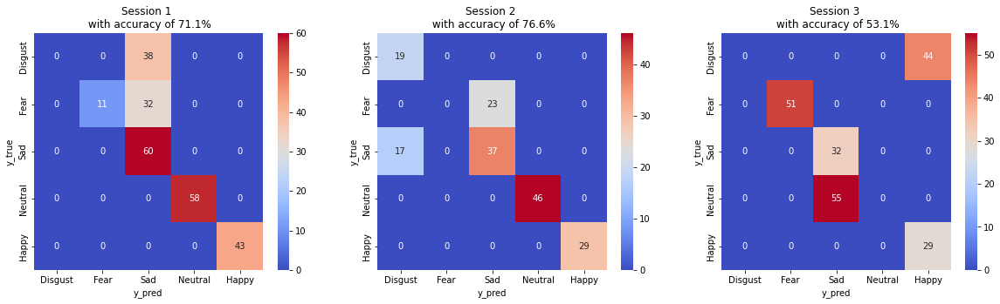

In [99]:
score =  np.zeros(3)
fig, axes = plt.subplots(1,3, figsize= (20,5))
label = ['Disgust', 'Fear', 'Sad', 'Neutral', 'Happy']

for session in range(3):
    model = SVC(C= 2, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    accuracy = accuracy_score(y_true = y_test[session], y_pred = yhat)
    score[session] = accuracy
    sns.heatmap(confusion_matrix(y_true = y_test[session], y_pred = yhat),
                annot= True, cmap= 'coolwarm', ax = axes[session])

    axes[session].set_xlabel('y_pred')
    axes[session].set_ylabel('y_true')
    axes[session].set_xticklabels(label)
    axes[session].set_yticklabels(label)
    axes[session].set_title(f'Session {session +1} \n with accuracy of {np.round(accuracy *100, 1)}%')

print(f'Accuracy of each session is: {score}')
print(f"With the average score at: {np.round((score.mean() *100), 1)}% ")

## Try NN participant 1, session 1

#### Use MLP from sklearn 

Accuracy of each session is: [0.84297521 0.74853801 0.53080569]
With the average score at: 70.7% 


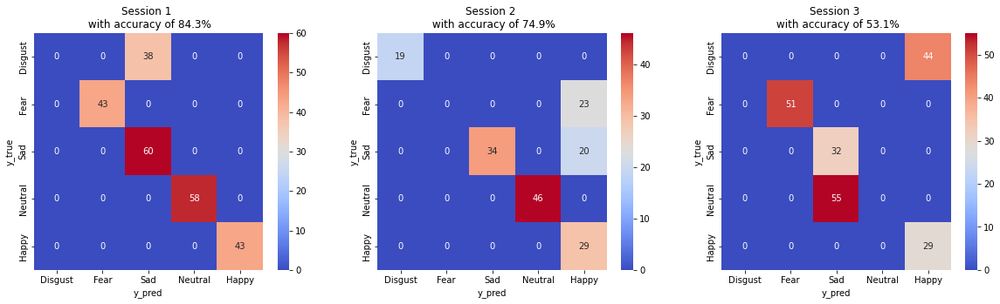

In [102]:
score =  np.zeros(3)
fig, axes = plt.subplots(1,3, figsize= (20,5))
label = ['Disgust', 'Fear', 'Sad', 'Neutral', 'Happy']

for session in range(3):
    model = MLPClassifier( activation='relu',max_iter=1000,
                          random_state=1, alpha = 0.001, batch_size= 200 )

    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    accuracy = accuracy_score(y_true = y_test[session], y_pred = yhat)
    score[session] = accuracy
    sns.heatmap(confusion_matrix(y_true = y_test[session], y_pred = yhat),
                annot= True, cmap= 'coolwarm', ax = axes[session])

    axes[session].set_xlabel('y_pred')
    axes[session].set_ylabel('y_true')
    axes[session].set_xticklabels(label)
    axes[session].set_yticklabels(label)
    axes[session].set_title(f'Session {session +1} \n with accuracy of {np.round(accuracy *100, 1)}%')

print(f'Accuracy of each session is: {score}')
print(f"With the average score at: {np.round((score.mean() *100), 1)}% ")

### Use pytorch

In [104]:
train_dataset = TensorDataset(torch.FloatTensor(X_train[0]), torch.LongTensor(y_train[0]))
train_dataloader = DataLoader(train_dataset, batch_size = 20, shuffle = True)

In [105]:
for i, a in train_dataloader:
    print(i.shape, a.shape)

torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([19, 310]) torch.Size([19])


In [106]:
input_size = 310      
output_size = 5
hidden_size_1 = 200  
hidden_size_2 = 50  

epochs = 1000
batch_size = 100
learning_rate = 0.0001

In [107]:
class Network(nn.Module):
    
    # In the initialization
    def __init__(self):
        super(Network, self).__init__()
        self.fc1 = nn.Linear(input_size, hidden_size_2)
        self.fc2 = nn.Linear(hidden_size_2, output_size)
        self.relu = nn.ReLU()

    # In forward propagation
    def forward(self, X_train):
        x = self.fc1(X_train)
        x = self.relu(x)
        x = self.fc2(x)

        return x

In [108]:
model = Network()
optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
loss_func = nn.CrossEntropyLoss()

In [109]:
model

Network(
  (fc1): Linear(in_features=310, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=5, bias=True)
  (relu): ReLU()
)

In [110]:
optimizer

SGD (
Parameter Group 0
    dampening: 0
    lr: 0.0001
    momentum: 0.9
    nesterov: False
    weight_decay: 0
)

In [111]:
# tX_train = Variable(torch.FloatTensor(X_train[session]), requires_grad = True)
# ty_train = torch.from_numpy(y_train[session]).long()

# print(tX_train.size())
# print(ty_train.size())

tX_test = torch.FloatTensor(X_test[0])
ty_test = torch.LongTensor(y_test[0])

# print(tX_test.size())
# print(ty_test.size())

loss_log = []                                 
for e in range(epochs):    
    for i, (data, labels) in enumerate(train_dataloader):         

        optimizer.zero_grad()
        net_out = model(data)
        # print(net_out.shape)

        loss = loss_func(net_out, labels)
        loss.backward()
        optimizer.step()
        
        if i % 200 == 0:
            # print(loss)
            loss_log.append(loss.item())
    if e % 100 == 0:
      print('Epoch: {} - Loss: {:.6f}'.format(e, loss.item()))
# test_var = Variable(tX_test)
# print(f"test shape: {test_var.shape}")

output = model(tX_test)
# print(f"output shape: {output.shape}")

# out prediction
final_output = (torch.max(output.data, 1)[1])
# print(f"final output shape: {final_output.shape}")

total = ty_test.size(0)  
correct = (final_output == ty_test).sum().item()         

print('Accuracy of the NN : {} %'.format(100 * correct / total))

Epoch: 0 - Loss: 1.591012
Epoch: 100 - Loss: 0.280938
Epoch: 200 - Loss: 0.127556
Epoch: 300 - Loss: 0.052733
Epoch: 400 - Loss: 0.037163
Epoch: 500 - Loss: 0.023167
Epoch: 600 - Loss: 0.019849
Epoch: 700 - Loss: 0.009919
Epoch: 800 - Loss: 0.011774
Epoch: 900 - Loss: 0.010526
Accuracy of the NN : 84.29752066115702 %


In [112]:
final_output

tensor([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2])

## Try NN participant 1, session 2





In [113]:
train_dataset = TensorDataset(torch.FloatTensor(X_train[1]), torch.LongTensor(y_train[1]))
train_dataloader = DataLoader(train_dataset, batch_size = 20, shuffle = False)

In [114]:
for i, a in train_dataloader:
    print(i.shape, a.shape)

torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([10, 310]) torch.Size([10])


In [115]:
input_size = 310      
output_size = 5
hidden_size_1 = 200  
hidden_size_2 = 50  

epochs = 1000
batch_size = 100
learning_rate = 0.0001

In [116]:
model2 = Network()
optimizer2 = optim.SGD(model2.parameters(), lr=learning_rate, momentum =0.9)         
loss_func2 = nn.CrossEntropyLoss()

In [117]:
# tX_train = Variable(torch.FloatTensor(X_train[session]), requires_grad = True)
# ty_train = torch.from_numpy(y_train[session]).long()

# print(tX_train.size())
# print(ty_train.size())

tX_test = torch.FloatTensor(X_test[1])
ty_test = torch.LongTensor(y_test[1])

# print(tX_test.size())
# print(ty_test.size())

loss_log = []                                 
for e in range(epochs):    
    for i, (data, labels) in enumerate(train_dataloader):         

        optimizer2.zero_grad()
        net_out = model2(data)
        # print(net_out.shape)

        loss = loss_func2(net_out, labels)
        loss.backward()
        optimizer2.step()
        
        if i % 200 == 0:
            # print(loss)
            loss_log.append(loss.item())

    if e % 100 == 0:
      print('Epoch: {} - Loss: {:.6f}'.format(e, loss.item()))
# test_var = Variable(tX_test)
# print(f"test shape: {test_var.shape}")

output = model2(tX_test)
# print(f"output shape: {output.shape}")

# out prediction
final_output = (torch.max(output.data, 1)[1])
# print(f"final output shape: {final_output.shape}")

total = ty_test.size(0)  
correct = (final_output == ty_test).sum().item()         

print('Accuracy of the NN : {} %'.format(100 * correct / total))

Epoch: 0 - Loss: 1.965541
Epoch: 100 - Loss: 0.682610
Epoch: 200 - Loss: 0.121787
Epoch: 300 - Loss: 0.044353
Epoch: 400 - Loss: 0.024629
Epoch: 500 - Loss: 0.016418
Epoch: 600 - Loss: 0.012057
Epoch: 700 - Loss: 0.009392
Epoch: 800 - Loss: 0.007632
Epoch: 900 - Loss: 0.006393
Accuracy of the NN : 54.97076023391813 %


In [118]:
final_output

tensor([3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
        3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0])

## Try NN participant 1, session 3

In [119]:
train_dataset = TensorDataset(torch.FloatTensor(X_train[2]), torch.LongTensor(y_train[2]))
train_dataloader = DataLoader(train_dataset, batch_size = 20, shuffle = False)

In [120]:
for i, a in train_dataloader:
    print(i.shape, a.shape)

torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([20, 310]) torch.Size([20])
torch.Size([10, 310]) torch.Size([10])


In [121]:
input_size = 310      
output_size = 5
hidden_size_1 = 200  
hidden_size_2 = 50  

epochs = 1000
batch_size = 100
learning_rate = 0.0001

In [122]:
model3 = Network()
optimizer3 = optim.SGD(model3.parameters(), lr=learning_rate, momentum =0.9)         
loss_func3 = nn.CrossEntropyLoss()

In [123]:
# tX_train = Variable(torch.FloatTensor(X_train[session]), requires_grad = True)
# ty_train = torch.from_numpy(y_train[session]).long()

# print(tX_train.size())
# print(ty_train.size())

tX_test = torch.FloatTensor(X_test[2])
ty_test = torch.LongTensor(y_test[2])

# print(tX_test.size())
# print(ty_test.size())

loss_log = []                                 
for e in range(epochs):    
    for i, (data, labels) in enumerate(train_dataloader):         

        optimizer3.zero_grad()
        net_out = model3(data)
        # print(net_out.shape)

        loss = loss_func3(net_out, labels)
        loss.backward()
        optimizer3.step()
        
        if i % 200 == 0:
            # print(loss)
            loss_log.append(loss.item())

    if e % 100 == 0:
      print('Epoch: {} - Loss: {:.6f}'.format(e, loss.item()))
# test_var = Variable(tX_test)
# print(f"test shape: {test_var.shape}")

output = model3(tX_test)
# print(f"output shape: {output.shape}")

# out prediction
final_output = (torch.max(output.data, 1)[1])
# print(f"final output shape: {final_output.shape}")

total = ty_test.size(0)  
correct = (final_output == ty_test).sum().item()         

print('Accuracy of the NN : {} %'.format(100 * correct / total))

Epoch: 0 - Loss: 1.478995
Epoch: 100 - Loss: 0.387173
Epoch: 200 - Loss: 0.036774
Epoch: 300 - Loss: 0.013561
Epoch: 400 - Loss: 0.007048
Epoch: 500 - Loss: 0.004607
Epoch: 600 - Loss: 0.003295
Epoch: 700 - Loss: 0.002547
Epoch: 800 - Loss: 0.002036
Epoch: 900 - Loss: 0.001700
Accuracy of the NN : 40.28436018957346 %


In [124]:
final_output

tensor([2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2,
        2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
        4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4])

In [125]:
for session in range(3):

    tX_train = Variable(torch.FloatTensor(X_train[session]), requires_grad = True)
    ty_train = torch.from_numpy(y_train[session]).long()

    # print(tX_train.size())
    # print(ty_train.size())

    tX_test = torch.from_numpy(X_test[session]).float()
    ty_test = torch.from_numpy(y_test[session]).long()

    # print(tX_test.size())
    # print(ty_test.size())
    
    loss_log = []                                 
    for e in range(epochs):    
        for i in range(0, tX_train.shape[0], batch_size):       
            x_mini = tX_train[i:i + batch_size]         
            #print(x_mini)        
            y_mini = ty_train[i:i + batch_size]         
            # x_var = Variable(x_mini.float())
            # y_var = Variable(y_mini.long())
            
            optimizer.zero_grad()
            net_out = model(x_mini)
            # print(net_out.shape)
            loss = loss_func(net_out, y_mini)
            # print(loss)
            loss.backward()
            optimizer.step()
            
            if i % 100 == 0:
                loss_log.append(loss.item())

      # if e % 100 == 0:
      #   print('Epoch: {} - Loss: {:.6f}'.format(e, loss.item()))
    # test_var = Variable(tX_test)
    # print(f"test shape: {test_var.shape}")
    
    output = model(tX_test)
    # print(f"output shape: {output.shape}")

    # out prediction
    final_output = (torch.max(output.data, 1)[1])
    # print(f"final output shape: {final_output.shape}")

    total = ty_test.size(0)  
    correct = (final_output == ty_test).sum().item()         

    print('Accuracy of the NN : {} %'.format(100 * correct / total))

Accuracy of the NN : 84.29752066115702 %
Accuracy of the NN : 68.42105263157895 %
Accuracy of the NN : 100.0 %


# 4) Train and test against hypotheses

### Create create_file functions
to read all 16 files from 16 participants, within which all brain signals are stored in dictionary format

In [12]:
data_npz = np.load('/content/gdrive/MyDrive/Datasets/preprocessed_data/1_123.npz')
print(data_npz.files)

['data', 'label']


In [13]:
def create_file():
    alldata = []
    alllabel = []

    for files in range(1, 17):
        filepath = f'/content/gdrive/MyDrive/Datasets/preprocessed_data/{files}_123.npz'
        data_npz = np.load(filepath)
        file_data = pickle.loads(data_npz['data'])
        file_label = pickle.loads(data_npz['label'])
        alldata.append(file_data)
        alllabel.append(file_label)
    
    return alldata, alllabel

In [14]:
data = []
label = []

for files in range(1, 17):
    filepath = f'/content/gdrive/MyDrive/Datasets/preprocessed_data/{files}_123.npz'
    data_npz = np.load(filepath)
    file_data = pickle.loads(data_npz['data'])
    file_label = pickle.loads(data_npz['label'])
    data.append(file_data)
    label.append(file_label)
    # print(files)

In [15]:
print(len(data))
print(len(label))

16
16


## Create participantData class

In [145]:
# Class without stacking
Class participantData:

    def __init__(self, frequency_band = 'all'):


        data, label = create_file()
        self.number_participant = len(data)
        self.number_clips = len(data[0])
        self.frequency_band = frequency_band

        self.alldata = data



        if self.frequency_band == 'all':
            pass
        
    
        elif self.frequency_band == 'delta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , : 62]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'theta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 62: 124]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'alpha':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 124: 186]
                    assert self.alldata[participant][clips].shape[1] == 62
        
        elif self.frequency_band == 'beta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 186: 248]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'gamma':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 248: 310]
                    assert self.alldata[participant][clips].shape[1] == 62
        else:
            raise ValueError("frequency band list: [delta, theta, alpha, beta, gamma, or all")
                

    def create_train_test(self):
        number_session = 3
        train_start_stop_1 = (0, 9)
        train_start_stop_2 = (15, 24)
        train_start_stop_3 = (30, 39)

        test_start_stop_1 = (10, 14)
        test_start_stop_2 = (25, 29)
        test_start_stop_3 = (40, 44)

        train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
        test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]


        X_train = [[0,0,0]  for participant in range(self.number_participant)]
        y_train = [[0,0,0]  for participant in range(self.number_participant)]

        X_test = [[0,0,0]  for participant in range(self.number_participant)]
        y_test = [[0,0,0]  for participant in range(self.number_participant)]


        ## TRAIN DATA
        for participant in range(self.number_participant) :
            for session in range(number_session):
                count = 0
   

                for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtrain_data = data[participant][clips]
                        Ytrain_data  = label[participant][clips]
                        count += 1
                        
                    else:
                        Xtrain_data = np.vstack((Xtrain_data, data[participant][clips]))
                        Ytrain_data = np.concatenate((Ytrain_data, label[participant][clips]))
                        count += 1
                        

                assert Xtrain_data.shape[0] == len(Ytrain_data)        
                assert count == 10 
                X_train[participant][session] = Xtrain_data
                y_train[participant][session] = Ytrain_data
                
        # TEST
        for participant in range(self.number_participant) : 
            for session in range(number_session):
                count = 0
            

                for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtest_data = data[participant][clips]
                        ytest_data  = label[participant][clips]
                        count += 1
                        
                    else:
                        Xtest_data = np.vstack((Xtest_data, data[participant][clips]))
                        ytest_data = np.concatenate((ytest_data, label[participant][clips]))
                        count += 1
                        

                assert Xtest_data.shape[0] == len(ytest_data)        
                assert count == 5 
                X_test[participant][session] = Xtest_data
                y_test[participant][session] = ytest_data


        return X_train, X_test, y_train, y_test

In [146]:
new = participantData('all')
a, b, c, d = new.create_train_test()

In [149]:
avg_score = []

for participant in range(16):
    session_score = []
    for session in range(3):
        model = SVC(C= 20, kernel = 'rbf', degree= 3)
        model.fit(a[participant][session], c[participant][session])
        yhat = model.predict(b[participant][session])
        score = accuracy_score(y_true = d[participant][session], y_pred = yhat)
        session_score.append(score)
        print(f"accuracy of {participant+1} participant at {session +1} session: {score}")
    
    print(f"average accuracy of {participant+1} participant: {np.mean(session_score)}")
    print()
    avg_score.append(np.mean(session_score))

accuracy of 1 participant at 1 session: 0.6900826446280992
accuracy of 1 participant at 2 session: 0.7660818713450293
accuracy of 1 participant at 3 session: 0.5308056872037915
average accuracy of 1 participant: 0.6623234010589734

accuracy of 2 participant at 1 session: 0.7520661157024794
accuracy of 2 participant at 2 session: 0.9883040935672515
accuracy of 2 participant at 3 session: 0.8483412322274881
average accuracy of 2 participant: 0.8629038138324064

accuracy of 3 participant at 1 session: 0.35537190082644626
accuracy of 3 participant at 2 session: 0.783625730994152
accuracy of 3 participant at 3 session: 0.5308056872037915
average accuracy of 3 participant: 0.5566011063414633

accuracy of 4 participant at 1 session: 0.2603305785123967
accuracy of 4 participant at 2 session: 0.38596491228070173
accuracy of 4 participant at 3 session: 0.7251184834123223
average accuracy of 4 participant: 0.45713799140180694

accuracy of 5 participant at 1 session: 0.47107438016528924
accuracy o

In [150]:
avg_score

[0.6623234010589734,
 0.8629038138324064,
 0.5566011063414633,
 0.45713799140180694,
 0.46664296731191673,
 0.42557673456333295,
 0.6370259432347009,
 0.6740378226126201,
 0.6306284154194538,
 0.2346856472233465,
 0.5428361637799494,
 0.4772048703090223,
 0.6613472915203112,
 0.3939819596297067,
 0.4483318944984742,
 0.4186649063176875]

In [151]:
np.mean(avg_score)

0.5343706830659483

## SUBJECT-INDEPENDENT

**We use stacked class**

In [107]:
# Class with stacking
class participantData:

    def __init__(self, frequency_band = 'all'):


        self.alldata , self.alllabel = create_file()
        self.number_participant = len(self.alldata)
        self.number_clips = len(self.alldata[0])
        self.frequency_band = frequency_band

       
        if self.frequency_band == 'all':
            pass
        
    
        elif self.frequency_band == 'delta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , : 62]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'theta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 62: 124]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'alpha':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 124: 186]
                    assert self.alldata[participant][clips].shape[1] == 62
        
        elif self.frequency_band == 'beta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 186: 248]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'gamma':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 248: 310]
                    assert self.alldata[participant][clips].shape[1] == 62
        else:
            raise ValueError("frequency band list: [delta, theta, alpha, beta, gamma, or all")
                

    def create_train_test(self, stack = False):
        # print(self.alldata[0][0].shape)
        # print(self.alllabel[0][0].shape)
        number_session = 3
        train_start_stop_1 = (0, 9)
        train_start_stop_2 = (15, 24)
        train_start_stop_3 = (30, 39)

        test_start_stop_1 = (10, 14)
        test_start_stop_2 = (25, 29)
        test_start_stop_3 = (40, 44)

        train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
        test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]


        X_train = [[0,0,0]  for participant in range(self.number_participant)]
        y_train = [[0,0,0]  for participant in range(self.number_participant)]

        X_test = [[0,0,0]  for participant in range(self.number_participant)]
        y_test = [[0,0,0]  for participant in range(self.number_participant)]


        ## TRAIN DATA
        for participant in range(self.number_participant) :
            for session in range(number_session):
                count = 0
   

                for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtrain_data = self.alldata[participant][clips]
                        Ytrain_data  = self.alllabel[participant][clips]
                        count += 1
                        
                    else:
                        Xtrain_data = np.vstack((Xtrain_data, self.alldata[participant][clips]))
                        Ytrain_data = np.concatenate((Ytrain_data, self.alllabel[participant][clips]))
                        count += 1
                        

                assert Xtrain_data.shape[0] == len(Ytrain_data)        
                assert count == 10 
                X_train[participant][session] = Xtrain_data
                y_train[participant][session] = Ytrain_data
                
        # TEST
        for participant in range(self.number_participant) : 
            for session in range(number_session):
                count = 0
            

                for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtest_data = self.alldata[participant][clips]
                        ytest_data  = self.alllabel[participant][clips]
                        count += 1
                        
                    else:
                        Xtest_data = np.vstack((Xtest_data, self.alldata[participant][clips]))
                        ytest_data = np.concatenate((ytest_data, self.alllabel[participant][clips]))
                        count += 1
                        

                assert Xtest_data.shape[0] == len(ytest_data)        
                assert count == 5 
                X_test[participant][session] = Xtest_data
                y_test[participant][session] = ytest_data

        if stack == False:
            pass
        else:
            stackedX_train = [[0]  for participant in range(self.number_participant)]
            stackedy_train = [[0]  for participant in range(self.number_participant)]

            stackedX_test = [[0]  for participant in range(self.number_participant)]
            stackedy_test = [[0]  for participant in range(self.number_participant)]


            # print(len(stackedX_train))
            count = 0
            for participant in range(self.number_participant) :

                for session in range(number_session):
                    if session == 0:
                        stackedX_train[participant] = X_train[participant][session]
                        stackedy_train[participant] = y_train[participant][session]
                        stackedX_test[participant] = X_test[participant][session]
                        stackedy_test[participant] = y_test[participant][session]
                        count +=1

                    else:
                        stackedX_train[participant] = np.vstack((stackedX_train[participant], X_train[participant][session] ))
                        stackedy_train[participant] = np.concatenate((stackedy_train[participant] ,y_train[participant][session] ))
                        stackedX_test[participant] = np.vstack((stackedX_test[participant], X_test[participant][session] ))
                        stackedy_test[participant] = np.concatenate((stackedy_test[participant] ,y_test[participant][session] ))
                        count +=1

            assert count == 48




        return X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test

### SVM model

####Delta band

In [153]:
delta_dataset = participantData('delta')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = delta_dataset.create_train_test(stack= True)

In [154]:
print(stackedX_train[0].shape)
print(stackedX_test[0].shape)
print(stackedy_train[0].shape)
print(stackedy_test[0].shape)

(1199, 62)
(624, 62)
(1199,)
(624,)


In [155]:
delta_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    delta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of delta band of all 16 participants: {np.mean(delta_SVM_partipation_accuracy)}")



Accuracy of the 0 participant: 0.6394230769230769
Accuracy of the 1 participant: 0.594551282051282
Accuracy of the 2 participant: 0.41185897435897434
Accuracy of the 3 participant: 0.5608974358974359
Accuracy of the 4 participant: 0.532051282051282
Accuracy of the 5 participant: 0.49198717948717946
Accuracy of the 6 participant: 0.7003205128205128
Accuracy of the 7 participant: 0.391025641025641
Accuracy of the 8 participant: 0.48878205128205127
Accuracy of the 9 participant: 0.2532051282051282
Accuracy of the 10 participant: 0.5480769230769231
Accuracy of the 11 participant: 0.5560897435897436
Accuracy of the 12 participant: 0.6217948717948718
Accuracy of the 13 participant: 0.5641025641025641
Accuracy of the 14 participant: 0.27564102564102566
Accuracy of the 15 participant: 0.40705128205128205

accuracy of delta band of all 16 participants: 0.5023036858974359


####Theta band

In [156]:
theta_dataset = participantData('theta')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = theta_dataset.create_train_test(stack= True)


theta_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    theta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of theta band of all 16 participants: {np.mean(theta_SVM_partipation_accuracy)}")

Accuracy of the 0 participant: 0.5576923076923077
Accuracy of the 1 participant: 0.5897435897435898
Accuracy of the 2 participant: 0.3701923076923077
Accuracy of the 3 participant: 0.6538461538461539
Accuracy of the 4 participant: 0.5608974358974359
Accuracy of the 5 participant: 0.6185897435897436
Accuracy of the 6 participant: 0.6778846153846154
Accuracy of the 7 participant: 0.6987179487179487
Accuracy of the 8 participant: 0.6057692307692307
Accuracy of the 9 participant: 0.32211538461538464
Accuracy of the 10 participant: 0.47115384615384615
Accuracy of the 11 participant: 0.3125
Accuracy of the 12 participant: 0.5032051282051282
Accuracy of the 13 participant: 0.36217948717948717
Accuracy of the 14 participant: 0.3814102564102564
Accuracy of the 15 participant: 0.3685897435897436

accuracy of theta band of all 16 participants: 0.5034054487179487


####Alpha band

In [157]:
alpha_dataset = participantData('alpha')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = alpha_dataset.create_train_test(stack= True)


alpha_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    alpha_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of alpha band of all 16 participants: {np.mean(alpha_SVM_partipation_accuracy)}")

Accuracy of the 0 participant: 0.6073717948717948
Accuracy of the 1 participant: 0.2900641025641026
Accuracy of the 2 participant: 0.3269230769230769
Accuracy of the 3 participant: 0.6714743589743589
Accuracy of the 4 participant: 0.5016025641025641
Accuracy of the 5 participant: 0.22916666666666666
Accuracy of the 6 participant: 0.7211538461538461
Accuracy of the 7 participant: 0.3814102564102564
Accuracy of the 8 participant: 0.6442307692307693
Accuracy of the 9 participant: 0.4583333333333333
Accuracy of the 10 participant: 0.32532051282051283
Accuracy of the 11 participant: 0.22756410256410256
Accuracy of the 12 participant: 0.6602564102564102
Accuracy of the 13 participant: 0.3125
Accuracy of the 14 participant: 0.47275641025641024
Accuracy of the 15 participant: 0.4583333333333333

accuracy of alpha band of all 16 participants: 0.45552884615384615


####Beta band

In [158]:
beta_dataset = participantData('beta')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = beta_dataset.create_train_test(stack= True)


beta_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    beta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of theta band of all 16 participants: {np.mean(beta_SVM_partipation_accuracy)}")

Accuracy of the 0 participant: 0.5833333333333334
Accuracy of the 1 participant: 0.41025641025641024
Accuracy of the 2 participant: 0.5817307692307693
Accuracy of the 3 participant: 0.9038461538461539
Accuracy of the 4 participant: 0.5849358974358975
Accuracy of the 5 participant: 0.3605769230769231
Accuracy of the 6 participant: 0.40384615384615385
Accuracy of the 7 participant: 0.6971153846153846
Accuracy of the 8 participant: 0.8942307692307693
Accuracy of the 9 participant: 0.5336538461538461
Accuracy of the 10 participant: 0.5657051282051282
Accuracy of the 11 participant: 0.39903846153846156
Accuracy of the 12 participant: 0.8381410256410257
Accuracy of the 13 participant: 0.4967948717948718
Accuracy of the 14 participant: 0.4182692307692308
Accuracy of the 15 participant: 0.5288461538461539

accuracy of theta band of all 16 participants: 0.575020032051282


####Gamma band

In [159]:
gamma_dataset = participantData('gamma')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = gamma_dataset.create_train_test(stack= True)


gamma_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    gamma_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of gamma band of all 16 participants: {np.mean(gamma_SVM_partipation_accuracy)}")

Accuracy of the 0 participant: 0.38461538461538464
Accuracy of the 1 participant: 0.5657051282051282
Accuracy of the 2 participant: 0.453525641025641
Accuracy of the 3 participant: 0.7003205128205128
Accuracy of the 4 participant: 0.4358974358974359
Accuracy of the 5 participant: 0.3525641025641026
Accuracy of the 6 participant: 0.5272435897435898
Accuracy of the 7 participant: 0.6442307692307693
Accuracy of the 8 participant: 0.6282051282051282
Accuracy of the 9 participant: 0.6714743589743589
Accuracy of the 10 participant: 0.5144230769230769
Accuracy of the 11 participant: 0.4230769230769231
Accuracy of the 12 participant: 0.6474358974358975
Accuracy of the 13 participant: 0.40384615384615385
Accuracy of the 14 participant: 0.40384615384615385
Accuracy of the 15 participant: 0.5721153846153846

accuracy of gamma band of all 16 participants: 0.5205328525641025


####All bands

In [160]:
allbands_dataset = participantData('all')
X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test = allbands_dataset.create_train_test(stack= True)


all_SVM_partipation_accuracy = []

for participant in range(16):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(stackedX_train[participant], stackedy_train[participant])
    yhat = model.predict(stackedX_test[participant])
    score = accuracy_score(y_true = stackedy_test[participant], y_pred = yhat)
    all_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {participant} participant: {score}')

print()
print(f"accuracy of all bands of all 16 participants: {np.mean(all_SVM_partipation_accuracy)}")

Accuracy of the 0 participant: 0.49198717948717946
Accuracy of the 1 participant: 0.7980769230769231
Accuracy of the 2 participant: 0.4407051282051282
Accuracy of the 3 participant: 0.7355769230769231
Accuracy of the 4 participant: 0.6105769230769231
Accuracy of the 5 participant: 0.5865384615384616
Accuracy of the 6 participant: 0.6490384615384616
Accuracy of the 7 participant: 0.717948717948718
Accuracy of the 8 participant: 0.9182692307692307
Accuracy of the 9 participant: 0.4855769230769231
Accuracy of the 10 participant: 0.6330128205128205
Accuracy of the 11 participant: 0.48717948717948717
Accuracy of the 12 participant: 0.7291666666666666
Accuracy of the 13 participant: 0.5689102564102564
Accuracy of the 14 participant: 0.40384615384615385
Accuracy of the 15 participant: 0.5528846153846154

accuracy of all bands of all 16 participants: 0.6130809294871795


#### Plot summary

In [165]:
np.vstack(((np.arange(1,17, dtype = int)), delta_SVM_partipation_accuracy, theta_SVM_partipation_accuracy,
           alpha_SVM_partipation_accuracy, beta_SVM_partipation_accuracy,
           gamma_SVM_partipation_accuracy, all_SVM_partipation_accuracy)).T.shape

(16, 7)

In [166]:
columns = ['participant', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
df_test = pd.DataFrame(data =np.vstack((np.arange(1,17, dtype= int), delta_SVM_partipation_accuracy, theta_SVM_partipation_accuracy,
           alpha_SVM_partipation_accuracy, beta_SVM_partipation_accuracy,
           gamma_SVM_partipation_accuracy, all_SVM_partipation_accuracy)).T, columns = columns)
df_test

,participant,delta,theta,alpha,beta,gamma,all
0,1.0,0.639423,0.557692,0.607372,0.583333,0.384615,0.491987
1,2.0,0.594551,0.589744,0.290064,0.410256,0.565705,0.798077
2,3.0,0.411859,0.370192,0.326923,0.581731,0.453526,0.440705
3,4.0,0.560897,0.653846,0.671474,0.903846,0.700321,0.735577
4,5.0,0.532051,0.560897,0.501603,0.584936,0.435897,0.610577
5,6.0,0.491987,0.618590,0.229167,0.360577,0.352564,0.586538
6,7.0,0.700321,0.677885,0.721154,0.403846,0.527244,0.649038
7,8.0,0.391026,0.698718,0.381410,0.697115,0.644231,0.717949
8,9.0,0.488782,0.605769,0.644231,0.894231,0.628205,0.918269
9,10.0,0.253205,0.322115,0.458333,0.533654,0.671474,0.485577


In [167]:
df = pd.melt(df_test, id_vars=['participant'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
df

,participant,frequency band,accuracy score
0,1.0,delta,0.639423
1,2.0,delta,0.594551
2,3.0,delta,0.411859
3,4.0,delta,0.560897
4,5.0,delta,0.532051
...,...,...,...
91,12.0,all,0.487179
92,13.0,all,0.729167
93,14.0,all,0.568910
94,15.0,all,0.403846


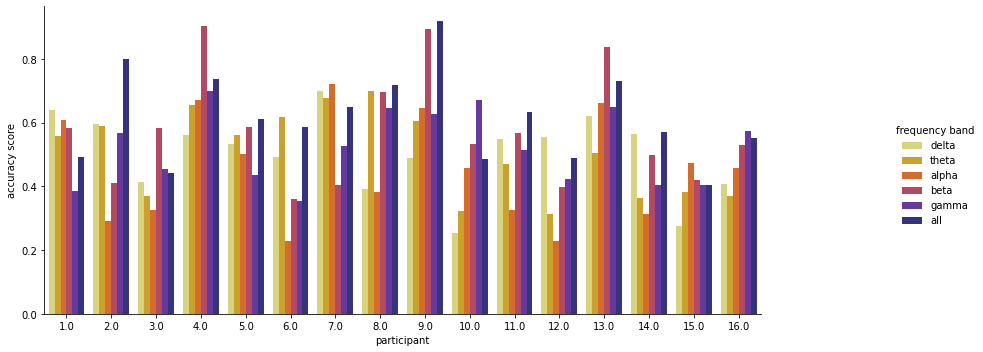

In [168]:
# plt.figure(figsize = (20,20))
g = sns.catplot(x='participant', y='accuracy score', hue='frequency band',
                data=df, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)

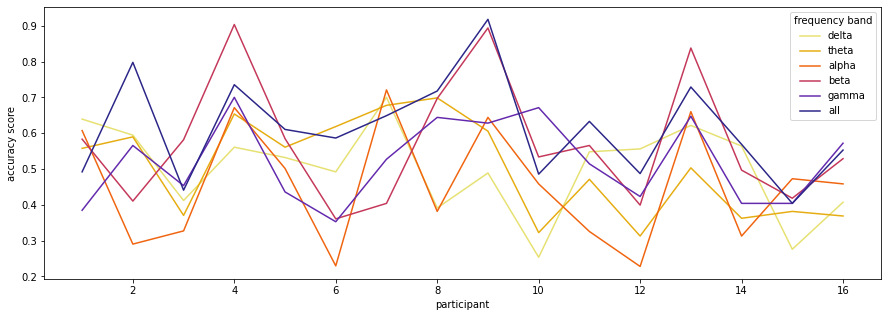

In [169]:
fig_dims = (15, 5)
fig, ax = plt.subplots(figsize=fig_dims)
sns.lineplot(x='participant', y='accuracy score', hue='frequency band',
                data=df, palette = "CMRmap_r", ax = ax)


delta    0.502304
theta    0.503405
alpha    0.455529
beta     0.575020
gamma    0.520533
all      0.613081
dtype: float64


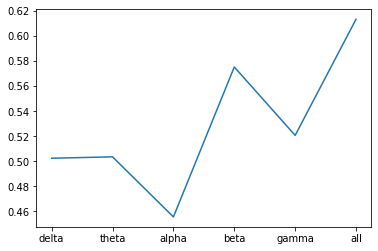

In [170]:
df_test.iloc[:, 1:].mean(axis = 0).plot()
print(df_test.iloc[:, 1:].mean(axis = 0))

### Neural Network model

In [22]:
data_npz = np.load('/content/gdrive/MyDrive/Datasets/preprocessed_data/1_123.npz')
print(data_npz.files)

['data', 'label']


In [23]:
def create_file():
    alldata = []
    alllabel = []

    for files in range(1, 17):
        filepath = f'/content/gdrive/MyDrive/Datasets/preprocessed_data/{files}_123.npz'
        data_npz = np.load(filepath)
        file_data = pickle.loads(data_npz['data'])
        file_label = pickle.loads(data_npz['label'])
        alldata.append(file_data)
        alllabel.append(file_label)
    
    return alldata, alllabel

In [24]:
alldata, alllabel = create_file()

**Set a class of Neural Network**

In [25]:
def parameters_reset(m):
    if isinstance(m, nn.Linear):
        m.reset_parameters()

In [26]:
class Network(nn.Module):
        # In the initialization
        def __init__(self):
            super(Network, self).__init__()
            self.fc1 = nn.Linear(input_size, hidden_size_1)
            self.fc2 = nn.Linear(hidden_size_1, hidden_size_2)
            self.fc3 = nn.Linear(hidden_size_2, output_size)
            self.relu = nn.ReLU()    
        # In forward propagation
        def forward(self, x):
            x = self.fc1(x)
            x = self.relu(x)
            x = self.fc2(x)
            x = self.relu(x)
            x = self.fc3(x)
            return x

**Class of participants**

In [21]:
class participantData:

    def __init__(self, frequency_band = 'all'):

        self.alldata , self.alllabel = create_file()
        self.number_participant = len(self.alldata)
        self.number_clips = len(self.alldata[0])
        self.frequency_band = frequency_band
       
        if self.frequency_band == 'all':
            pass
    
        elif self.frequency_band == 'delta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , : 62]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'theta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 62: 124]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'alpha':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 124: 186]
                    assert self.alldata[participant][clips].shape[1] == 62
        
        elif self.frequency_band == 'beta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 186: 248]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'gamma':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 248: 310]
                    assert self.alldata[participant][clips].shape[1] == 62
        else:
            raise ValueError("frequency band list: [delta, theta, alpha, beta, gamma, or all")
                
    def create_train_test(self, stack = False):
        # print(self.alldata[0][0].shape)
        # print(self.alllabel[0][0].shape)
        number_session = 3
        train_start_stop_1 = (0, 9)
        train_start_stop_2 = (15, 24)
        train_start_stop_3 = (30, 39)

        test_start_stop_1 = (10, 14)
        test_start_stop_2 = (25, 29)
        test_start_stop_3 = (40, 44)

        train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
        test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]

        X_train = [[0,0,0]  for participant in range(self.number_participant)]
        y_train = [[0,0,0]  for participant in range(self.number_participant)]

        X_test = [[0,0,0]  for participant in range(self.number_participant)]
        y_test = [[0,0,0]  for participant in range(self.number_participant)]

        ## TRAIN DATA
        for participant in range(self.number_participant) :
            for session in range(number_session):
                count = 0

                for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtrain_data = self.alldata[participant][clips]
                        Ytrain_data  = self.alllabel[participant][clips]
                        count += 1
                        
                    else:
                        Xtrain_data = np.vstack((Xtrain_data, self.alldata[participant][clips]))
                        Ytrain_data = np.concatenate((Ytrain_data, self.alllabel[participant][clips]))
                        count += 1
                        
                assert Xtrain_data.shape[0] == len(Ytrain_data)        
                assert count == 10 
                X_train[participant][session] = Xtrain_data
                y_train[participant][session] = Ytrain_data
                
        # TEST
        for participant in range(self.number_participant) : 
            for session in range(number_session):
                count = 0
            
                for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtest_data = self.alldata[participant][clips]
                        ytest_data  = self.alllabel[participant][clips]
                        count += 1
                        
                    else:
                        Xtest_data = np.vstack((Xtest_data, self.alldata[participant][clips]))
                        ytest_data = np.concatenate((ytest_data, self.alllabel[participant][clips]))
                        count += 1
                        
                assert Xtest_data.shape[0] == len(ytest_data)        
                assert count == 5 
                X_test[participant][session] = Xtest_data
                y_test[participant][session] = ytest_data

        if stack == False:
            pass
        else:
            stackedX_train = [[0]  for participant in range(self.number_participant)]
            stackedy_train = [[0]  for participant in range(self.number_participant)]

            stackedX_test = [[0]  for participant in range(self.number_participant)]
            stackedy_test = [[0]  for participant in range(self.number_participant)]

            # print(len(stackedX_train))
            count = 0
            for participant in range(self.number_participant) :

                for session in range(number_session):
                    if session == 0:
                        stackedX_train[participant] = X_train[participant][session]
                        stackedy_train[participant] = y_train[participant][session]
                        stackedX_test[participant] = X_test[participant][session]
                        stackedy_test[participant] = y_test[participant][session]
                        count +=1

                    else:
                        stackedX_train[participant] = np.vstack((stackedX_train[participant], X_train[participant][session] ))
                        stackedy_train[participant] = np.concatenate((stackedy_train[participant] ,y_train[participant][session] ))
                        stackedX_test[participant] = np.vstack((stackedX_test[participant], X_test[participant][session] ))
                        stackedy_test[participant] = np.concatenate((stackedy_test[participant] ,y_test[participant][session] ))
                        count +=1

            assert count == 48

        return X_train, X_test, y_train, y_test, stackedX_train, stackedX_test, stackedy_train , stackedy_test

#### Pre-TensorBoard 

**Hyperparameters for each band**

In [22]:
input_size = 62   
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

epochs = 500
batch_size = 32
learning_rate = 0.0001

##### Delta band

In [23]:
delta_dataset = participantData('delta')
X_train_delta, X_test_delta, y_train_delta, y_test_delta, stackedX_train_delta, stackedX_test_delta, stackedy_train_delta , stackedy_test_delta = delta_dataset.create_train_test(stack= True)

In [187]:
score_list_delta = []
loss_participant_delta_train_list = []

for participant in range(16):
    parti_acc_delta = []
    loss_participant_delta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_delta[participant]), torch.LongTensor(stackedy_train_delta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_delta[participant]), torch.LongTensor(stackedy_test_delta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_delta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_delta.append(score)
            scores = statistics.mean(parti_acc_delta)

    score_list_delta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_delta_train_list.append(loss_participant_delta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.9375


Accuracy of the 2 participant score: 0.7261513157894737


Accuracy of the 3 participant score: 0.6414473684210527


Accuracy of the 4 participant score: 0.3782894736842105


Accuracy of the 5 participant score: 0.33881578947368424


Accuracy of the 6 participant score: 0.6842105263157895


Accuracy of the 7 participant score: 0.584703947368421


Accuracy of the 8 participant score: 0.4942434210526316


Accuracy of the 9 participant score: 0.4375


Accuracy of the 10 participant score: 0.6488486842105263


Accuracy of the 11 participant score: 0.7631578947368421


Accuracy of the 12 participant score: 0.4136513157894737


Accuracy of the 13 participant score: 0.8511513157894737


Accuracy of the 14 participant score: 0.47286184210526316


Accuracy of the 15 participant score: 0.6644736842105263


Accuracy of the 16 participant score: 0.484375


##### Theta band

In [24]:
theta_dataset = participantData('theta')
X_train_theta, X_test_theta, y_train_theta, y_test_theta, stackedX_train_theta, stackedX_test_theta, stackedy_train_theta , stackedy_test_theta = theta_dataset.create_train_test(stack= True)

In [189]:
score_list_theta = []
loss_participant_theta_train_list = []

for participant in range(16):
    parti_acc_theta = []
    loss_participant_theta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_theta[participant]), torch.LongTensor(stackedy_train_theta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_theta[participant]), torch.LongTensor(stackedy_test_theta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_theta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_theta.append(score)
            scores = statistics.mean(parti_acc_theta)

    score_list_theta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_theta_train_list.append(loss_participant_theta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.8626644736842105


Accuracy of the 2 participant score: 0.6422697368421053


Accuracy of the 3 participant score: 0.7672697368421053


Accuracy of the 4 participant score: 0.7491776315789473


Accuracy of the 5 participant score: 0.5328947368421053


Accuracy of the 6 participant score: 0.5773026315789473


Accuracy of the 7 participant score: 0.8791118421052632


Accuracy of the 8 participant score: 0.6365131578947368


Accuracy of the 9 participant score: 0.7919407894736842


Accuracy of the 10 participant score: 0.7458881578947368


Accuracy of the 11 participant score: 0.5518092105263158


Accuracy of the 12 participant score: 0.48601973684210525


Accuracy of the 13 participant score: 0.8125


Accuracy of the 14 participant score: 0.49506578947368424


Accuracy of the 15 participant score: 0.7310855263157895


Accuracy of the 16 participant score: 0.634046052631579


##### Alpha band

In [25]:
alpha_dataset = participantData('alpha')
X_train_alpha, X_test_alpha, y_train_alpha, y_test_alpha, stackedX_train_alpha, stackedX_test_alpha, stackedy_train_alpha , stackedy_test_alpha = alpha_dataset.create_train_test(stack= True)

In [191]:
score_list_alpha = []
loss_participant_alpha_train_list = []

for participant in range(16):
    parti_acc_alpha = []
    loss_participant_alpha_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_alpha[participant]), torch.LongTensor(stackedy_train_alpha[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_alpha[participant]), torch.LongTensor(stackedy_test_alpha[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_participant_alpha_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_alpha.append(score)
            scores = statistics.mean(parti_acc_alpha)

    score_list_alpha.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_alpha_train_list.append(loss_participant_alpha_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.9629934210526315


Accuracy of the 2 participant score: 0.6751644736842105


Accuracy of the 3 participant score: 0.9580592105263158


Accuracy of the 4 participant score: 0.7985197368421053


Accuracy of the 5 participant score: 0.6587171052631579


Accuracy of the 6 participant score: 0.5962719298245615


Accuracy of the 7 participant score: 0.4925986842105263


Accuracy of the 8 participant score: 0.6461622807017544


Accuracy of the 9 participant score: 0.7212171052631579


Accuracy of the 10 participant score: 0.65625


Accuracy of the 11 participant score: 0.6513157894736842


Accuracy of the 12 participant score: 0.3412828947368421


Accuracy of the 13 participant score: 0.8610197368421053


Accuracy of the 14 participant score: 0.4613486842105263


Accuracy of the 15 participant score: 0.7401315789473685


Accuracy of the 16 participant score: 0.8462171052631579


##### Beta band

In [26]:
beta_dataset = participantData('beta')
X_train_beta, X_test_beta, y_train_beta, y_test_beta, stackedX_train_beta, stackedX_test_beta, stackedy_train_beta , stackedy_test_beta = beta_dataset.create_train_test(stack= True)

In [193]:
score_list_beta = []
loss_participant_beta_train_list = []

for participant in range(16):
    parti_acc_beta = []
    loss_participant_beta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_beta[participant]), torch.LongTensor(stackedy_train_beta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_beta[participant]), torch.LongTensor(stackedy_test_beta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:   
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_beta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_beta.append(score)
            scores = statistics.mean(parti_acc_beta)

    score_list_beta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_beta_train_list.append(loss_participant_beta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.7697368421052632


Accuracy of the 2 participant score: 0.6620065789473685


Accuracy of the 3 participant score: 0.6504934210526315


Accuracy of the 4 participant score: 0.5921052631578947


Accuracy of the 5 participant score: 0.4564144736842105


Accuracy of the 6 participant score: 0.537828947368421


Accuracy of the 7 participant score: 0.3684210526315789


Accuracy of the 8 participant score: 0.33963815789473684


Accuracy of the 9 participant score: 0.6677631578947368


Accuracy of the 10 participant score: 0.5016447368421053


Accuracy of the 11 participant score: 0.4909539473684211


Accuracy of the 12 participant score: 0.4942434210526316


Accuracy of the 13 participant score: 0.7705592105263158


Accuracy of the 14 participant score: 0.33881578947368424


Accuracy of the 15 participant score: 0.6504934210526315


Accuracy of the 16 participant score: 0.6258223684210527


##### Gamma band

In [27]:
gamma_dataset = participantData('gamma')
X_train_gamma, X_test_gamma, y_train_gamma, y_test_gamma, stackedX_train_gamma, stackedX_test_gamma, stackedy_train_gamma , stackedy_test_gamma = gamma_dataset.create_train_test(stack= True)

In [195]:
score_list_gamma = []
loss_participant_gamma_train_list = []

for participant in range(16):
    parti_acc_gamma = []
    loss_participant_gamma_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_gamma[participant]), torch.LongTensor(stackedy_train_gamma[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_gamma[participant]), torch.LongTensor(stackedy_test_gamma[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_participant_gamma_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_gamma.append(score)
            scores = statistics.mean(parti_acc_gamma)

    score_list_gamma.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_gamma_train_list.append(loss_participant_gamma_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.7467105263157895


Accuracy of the 2 participant score: 0.5649671052631579


Accuracy of the 3 participant score: 0.6949013157894737


Accuracy of the 4 participant score: 0.5921052631578947


Accuracy of the 5 participant score: 0.3996710526315789


Accuracy of the 6 participant score: 0.5805921052631579


Accuracy of the 7 participant score: 0.6266447368421053


Accuracy of the 8 participant score: 0.39144736842105265


Accuracy of the 9 participant score: 0.2889802631578947


Accuracy of the 10 participant score: 0.5600328947368421


Accuracy of the 11 participant score: 0.4753289473684211


Accuracy of the 12 participant score: 0.5592105263157895


Accuracy of the 13 participant score: 0.5263157894736842


Accuracy of the 14 participant score: 0.4018640350877193


Accuracy of the 15 participant score: 0.6694078947368421


Accuracy of the 16 participant score: 0.6504934210526315


##### All band

**Hyperparameter for all band**

In [28]:
input_size = 310   
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

epochs = 500
batch_size = 32
learning_rate = 0.0001

In [29]:
all_dataset = participantData('all')
X_train_all, X_test_all, y_train_all, y_test_all, stackedX_train_all, stackedX_test_all, stackedy_train_all , stackedy_test_all = all_dataset.create_train_test(stack= True)

In [198]:
score_list_all = []
loss_participant_all_train_list = []

for participant in range(16):
    parti_acc_all = []
    loss_participant_all_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_all[participant]), torch.LongTensor(stackedy_train_all[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_all[participant]), torch.LongTensor(stackedy_test_all[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:   
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_all_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_all.append(score)
            scores = statistics.mean(parti_acc_all)

    score_list_all.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_all_train_list.append(loss_participant_all_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.9572368421052632


Accuracy of the 2 participant score: 0.6611842105263158


Accuracy of the 3 participant score: 0.881578947368421


Accuracy of the 4 participant score: 0.8100328947368421


Accuracy of the 5 participant score: 0.7351973684210527


Accuracy of the 6 participant score: 0.6726973684210527


Accuracy of the 7 participant score: 0.7524671052631579


Accuracy of the 8 participant score: 0.6694078947368421


Accuracy of the 9 participant score: 0.48848684210526316


Accuracy of the 10 participant score: 0.8675986842105263


Accuracy of the 11 participant score: 0.6233552631578947


Accuracy of the 12 participant score: 0.5304276315789473


Accuracy of the 13 participant score: 0.915296052631579


Accuracy of the 14 participant score: 0.6052631578947368


Accuracy of the 15 participant score: 0.38980263157894735


Accuracy of the 16 participant score: 0.7171052631578947


##### Plot summary

In [199]:
columns = ['participant', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
df_pd_pre_participant = pd.DataFrame(data =np.vstack((np.arange(1,17, dtype= int), score_list_delta, score_list_theta,
           score_list_alpha, score_list_beta,
           score_list_gamma, score_list_all)).T, columns = columns)
df_pd_pre_participant

,participant,delta,theta,alpha,beta,gamma,all
0,1.0,0.937500,0.862664,0.962993,0.769737,0.746711,0.957237
1,2.0,0.726151,0.642270,0.675164,0.662007,0.564967,0.661184
2,3.0,0.641447,0.767270,0.958059,0.650493,0.694901,0.881579
3,4.0,0.378289,0.749178,0.798520,0.592105,0.592105,0.810033
4,5.0,0.338816,0.532895,0.658717,0.456414,0.399671,0.735197
5,6.0,0.684211,0.577303,0.596272,0.537829,0.580592,0.672697
6,7.0,0.584704,0.879112,0.492599,0.368421,0.626645,0.752467
7,8.0,0.494243,0.636513,0.646162,0.339638,0.391447,0.669408
8,9.0,0.437500,0.791941,0.721217,0.667763,0.288980,0.488487
9,10.0,0.648849,0.745888,0.656250,0.501645,0.560033,0.867599


In [200]:
df_pre_participant = pd.melt(df_pd_pre_participant, id_vars=['participant'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
df_pre_participant

,participant,frequency band,accuracy score
0,1.0,delta,0.937500
1,2.0,delta,0.726151
2,3.0,delta,0.641447
3,4.0,delta,0.378289
4,5.0,delta,0.338816
...,...,...,...
91,12.0,all,0.530428
92,13.0,all,0.915296
93,14.0,all,0.605263
94,15.0,all,0.389803


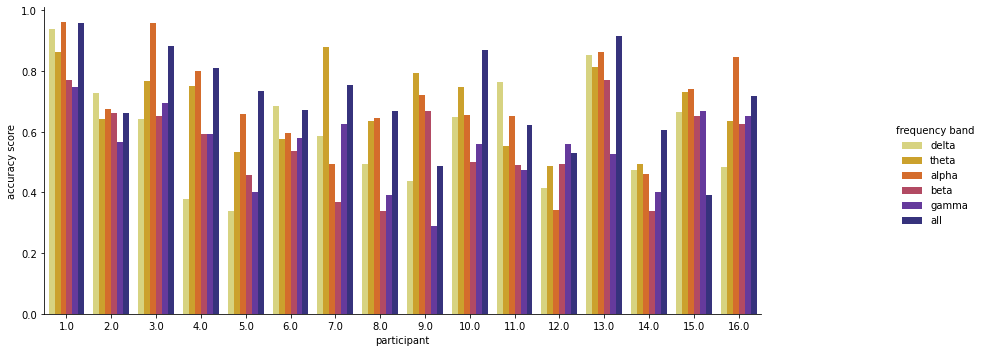

In [201]:
# plt.figure(figsize = (20,20))
g = sns.catplot(x='participant', y='accuracy score', hue='frequency band',
                data=df_pre_participant, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)

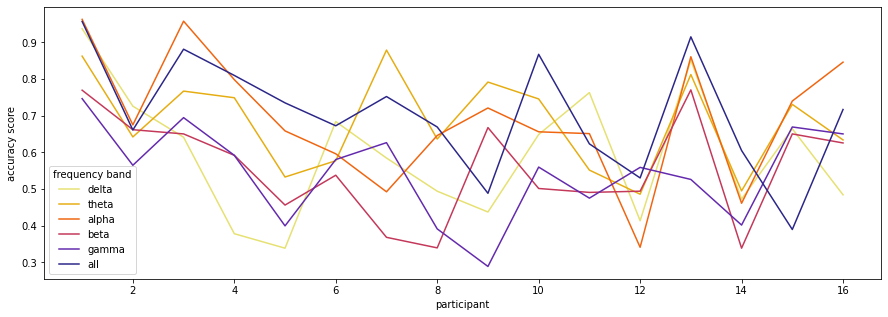

In [202]:
fig_dims = (15, 5)
fig, ax = plt.subplots(figsize=fig_dims)
sns.lineplot(x='participant', y='accuracy score', hue='frequency band',
                data=df_pre_participant, palette = "CMRmap_r", ax = ax)

#### TensorBoard

In [104]:
input_size = 310      
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5
epochs = 500
momentum = 0.9

###### Finding best hyperparameters


In [105]:
batch_sizes = [16, 32, 64]
learning_rates = [0.001, 0.0001]

**select 1st participant to find hyperparameters**


In [108]:
pick_dataset = participantData('all')

X_train_pick, X_test_pick, y_train_pick, y_test_pick, stackedX_train_pick, stackedX_test_pick, stackedy_train_pick , stackedy_test_pick = pick_dataset.create_train_test(stack= True)

In [112]:
parti_acc_all = []
for batch_size in batch_sizes:
    for lr in learning_rates:
      start_time = time.time()

      train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_pick[0]), torch.LongTensor(stackedy_train_pick[0]))
      test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_pick[0]), torch.LongTensor(stackedy_test_pick[0]))
      train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
      test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

      model = Network().to(device)
      optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum)         
      criterion = nn.CrossEntropyLoss()

      writer = SummaryWriter(f'/content/gdrive/MyDrive/logs/eeg_praticipant/batch_size={batch_size}_lr={lr}_momentum={momentum}')
       
      step = 0  
      print(f"Hyper parameters : batch_size={batch_size}_lr={lr}_momentum={momentum}") 

      losses = [] 

      model.train()    
      loop = tqdm(range(epochs), leave=False)                            
      for epoch in loop:
        
        running_loss = 0.0
        
        for i, (data, labels) in enumerate(train_dataloader): 
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            losses.append(loss.item())

            # writer.add_histogram('fc3',model.fc3.weight,step)
            # print statistic eg. loss  
            writer.add_scalar('Training_Loss',loss,step)
            step += 1 

            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

      writer.add_hparams({'lr': lr, 'bsize': batch_size},{'hparam/loss': sum(losses)/len(losses)})

      model.eval()
      with torch.no_grad():
          correct = 0
          total   = 0
          for data, labels in test_dataloader:
              data = data.to(device)
              labels = labels.to(device) 
              outputs = model(data)      
              # out prediction
              final_output = (torch.max(outputs.data, 1)[1])
              score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
              parti_acc_all.append(score)
              scores = statistics.mean(parti_acc_all)

      end_time = time.time() - start_time
      print(f'End time : {end_time}')
      model.apply(parameters_reset)

writer.close()
print("Training Done !")

Hyper parameters : batch_size=16_lr=0.001_momentum=0.9


End time : 200.62150049209595
Hyper parameters : batch_size=16_lr=0.0001_momentum=0.9


End time : 215.2152614593506
Hyper parameters : batch_size=32_lr=0.001_momentum=0.9


End time : 111.98495197296143
Hyper parameters : batch_size=32_lr=0.0001_momentum=0.9


End time : 112.44243025779724
Hyper parameters : batch_size=64_lr=0.001_momentum=0.9


End time : 58.699625730514526
Hyper parameters : batch_size=64_lr=0.0001_momentum=0.9


End time : 57.983081102371216
Training Done !


###### TensorBoard

In [113]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [114]:
%reload_ext tensorboard

In [115]:
%tensorboard --logdir=/content/gdrive/MyDrive/logs/eeg_praticipant/

Reusing TensorBoard on port 6006 (pid 2475), started 0:14:39 ago. (Use '!kill 2475' to kill it.)

<IPython.core.display.Javascript object>

Best hyperparameter

In [52]:
learning_rate = 0.0001
batch_size = 32
epochs = 500

In [110]:
# delete tensorboardlog logs

# !rm -rf /content/gdrive/MyDrive/logs/eeg_praticipant/

#### Post-TensorBoard

**Hyperparmeters' participant for each band**

In [53]:
input_size = 62     
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

#####Delta band 

In [54]:
delta_dataset = participantData('delta')

X_train_delta, X_test_delta, y_train_delta, y_test_delta, stackedX_train_delta, stackedX_test_delta, stackedy_train_delta , stackedy_test_delta = delta_dataset.create_train_test(stack= True)

In [55]:
score_list_delta = []
loss_participant_delta_train_list = []

for participant in range(16):
    parti_acc_delta = []
    loss_participant_delta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_delta[participant]), torch.LongTensor(stackedy_train_delta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_delta[participant]), torch.LongTensor(stackedy_test_delta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_delta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_delta.append(score)
            scores = statistics.mean(parti_acc_delta)

    score_list_delta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_delta_train_list.append(loss_participant_delta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.7713815789473685


Accuracy of the 2 participant score: 0.6726973684210527


Accuracy of the 3 participant score: 0.7064144736842105


Accuracy of the 4 participant score: 0.4662828947368421


Accuracy of the 5 participant score: 0.4128289473684211


Accuracy of the 6 participant score: 0.6200657894736842


Accuracy of the 7 participant score: 0.546875


Accuracy of the 8 participant score: 0.5550986842105263


Accuracy of the 9 participant score: 0.4564144736842105


Accuracy of the 10 participant score: 0.5304276315789473


Accuracy of the 11 participant score: 0.7319078947368421


Accuracy of the 12 participant score: 0.43338815789473684


Accuracy of the 13 participant score: 0.834703947368421


Accuracy of the 14 participant score: 0.4087171052631579


Accuracy of the 15 participant score: 0.6710526315789473


Accuracy of the 16 participant score: 0.6488486842105263


##### Theta band

In [56]:
theta_dataset = participantData('theta')

X_train_theta, X_test_theta, y_train_theta, y_test_theta, stackedX_train_theta, stackedX_test_theta, stackedy_train_theta , stackedy_test_theta = theta_dataset.create_train_test(stack= True)

In [57]:
score_list_theta = []
loss_participant_theta_train_list = []

for participant in range(16):
    parti_acc_theta = []
    loss_participant_theta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_theta[participant]), torch.LongTensor(stackedy_train_theta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_theta[participant]), torch.LongTensor(stackedy_test_theta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_theta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_theta.append(score)
            scores = statistics.mean(parti_acc_theta)

    score_list_theta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_theta_train_list.append(loss_participant_theta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.75


Accuracy of the 2 participant score: 0.6192434210526315


Accuracy of the 3 participant score: 0.837171052631579


Accuracy of the 4 participant score: 0.5995065789473685


Accuracy of the 5 participant score: 0.6578947368421053


Accuracy of the 6 participant score: 0.6247807017543859


Accuracy of the 7 participant score: 0.7919407894736842


Accuracy of the 8 participant score: 0.6710526315789473


Accuracy of the 9 participant score: 0.8108552631578947


Accuracy of the 10 participant score: 0.709703947368421


Accuracy of the 11 participant score: 0.5353618421052632


Accuracy of the 12 participant score: 0.4555921052631579


Accuracy of the 13 participant score: 0.7162828947368421


Accuracy of the 14 participant score: 0.5254934210526315


Accuracy of the 15 participant score: 0.7894736842105263


Accuracy of the 16 participant score: 0.7401315789473685


#####Alpha band

In [58]:
alpha_dataset = participantData('alpha')

X_train_alpha, X_test_alpha, y_train_alpha, y_test_alpha, stackedX_train_alpha, stackedX_test_alpha, stackedy_train_alpha , stackedy_test_alpha = alpha_dataset.create_train_test(stack= True)

In [59]:
score_list_alpha = []
loss_participant_alpha_train_list = []

for participant in range(16):
    parti_acc_alpha = []
    loss_participant_alpha_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_alpha[participant]), torch.LongTensor(stackedy_train_alpha[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_alpha[participant]), torch.LongTensor(stackedy_test_alpha[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_participant_alpha_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_alpha.append(score)
            scores = statistics.mean(parti_acc_alpha)

    score_list_alpha.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_alpha_train_list.append(loss_participant_alpha_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.90625


Accuracy of the 2 participant score: 0.8075657894736842


Accuracy of the 3 participant score: 0.921875


Accuracy of the 4 participant score: 0.7491776315789473


Accuracy of the 5 participant score: 0.647203947368421


Accuracy of the 6 participant score: 0.5164473684210527


Accuracy of the 7 participant score: 0.5394736842105263


Accuracy of the 8 participant score: 0.5390899122807018


Accuracy of the 9 participant score: 0.774671052631579


Accuracy of the 10 participant score: 0.6060855263157895


Accuracy of the 11 participant score: 0.6439144736842105


Accuracy of the 12 participant score: 0.4029605263157895


Accuracy of the 13 participant score: 0.8100328947368421


Accuracy of the 14 participant score: 0.37335526315789475


Accuracy of the 15 participant score: 0.694078947368421


Accuracy of the 16 participant score: 0.7993421052631579


#####Beta band

In [60]:
beta_dataset = participantData('beta')

X_train_beta, X_test_beta, y_train_beta, y_test_beta, stackedX_train_beta, stackedX_test_beta, stackedy_train_beta , stackedy_test_beta = beta_dataset.create_train_test(stack= True)

In [61]:
score_list_beta = []
loss_participant_beta_train_list = []

for participant in range(16):
    parti_acc_beta = []
    loss_participant_beta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_beta[participant]), torch.LongTensor(stackedy_train_beta[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_beta[participant]), torch.LongTensor(stackedy_test_beta[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:   
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_beta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_beta.append(score)
            scores = statistics.mean(parti_acc_beta)

    score_list_beta.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_beta_train_list.append(loss_participant_beta_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.6949013157894737


Accuracy of the 2 participant score: 0.6430921052631579


Accuracy of the 3 participant score: 0.5896381578947368


Accuracy of the 4 participant score: 0.6981907894736842


Accuracy of the 5 participant score: 0.3963815789473684


Accuracy of the 6 participant score: 0.5230263157894737


Accuracy of the 7 participant score: 0.37088815789473684


Accuracy of the 8 participant score: 0.33963815789473684


Accuracy of the 9 participant score: 0.662828947368421


Accuracy of the 10 participant score: 0.6052631578947368


Accuracy of the 11 participant score: 0.4901315789473684


Accuracy of the 12 participant score: 0.37993421052631576


Accuracy of the 13 participant score: 0.8001644736842105


Accuracy of the 14 participant score: 0.4440789473684211


Accuracy of the 15 participant score: 0.7524671052631579


Accuracy of the 16 participant score: 0.6636513157894737


#####Gamma band

In [62]:
gamma_dataset = participantData('gamma')

X_train_gamma, X_test_gamma, y_train_gamma, y_test_gamma, stackedX_train_gamma, stackedX_test_gamma, stackedy_train_gamma , stackedy_test_gamma = gamma_dataset.create_train_test(stack= True)

In [63]:
score_list_gamma = []
loss_participant_gamma_train_list = []

for participant in range(16):
    parti_acc_gamma = []
    loss_participant_gamma_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_gamma[participant]), torch.LongTensor(stackedy_train_gamma[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_gamma[participant]), torch.LongTensor(stackedy_test_gamma[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_participant_gamma_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_gamma.append(score)
            scores = statistics.mean(parti_acc_gamma)

    score_list_gamma.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_gamma_train_list.append(loss_participant_gamma_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.7870065789473685


Accuracy of the 2 participant score: 0.6291118421052632


Accuracy of the 3 participant score: 0.6414473684210527


Accuracy of the 4 participant score: 0.6101973684210527


Accuracy of the 5 participant score: 0.4745065789473684


Accuracy of the 6 participant score: 0.5789473684210527


Accuracy of the 7 participant score: 0.5888157894736842


Accuracy of the 8 participant score: 0.4161184210526316


Accuracy of the 9 participant score: 0.30098684210526316


Accuracy of the 10 participant score: 0.6101973684210527


Accuracy of the 11 participant score: 0.6192434210526315


Accuracy of the 12 participant score: 0.5057565789473685


Accuracy of the 13 participant score: 0.5649671052631579


Accuracy of the 14 participant score: 0.4120065789473684


Accuracy of the 15 participant score: 0.625


Accuracy of the 16 participant score: 0.7648026315789473


#####All bands

**Hyperparameters' participant for all band**

In [64]:
input_size = 310      
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

epochs = 500
batch_size = 32
learning_rate = 0.0001

In [65]:
all_dataset = participantData('all')

X_train_all, X_test_all, y_train_all, y_test_all, stackedX_train_all, stackedX_test_all, stackedy_train_all , stackedy_test_all = all_dataset.create_train_test(stack= True)

In [66]:
score_list_all = []
loss_participant_all_train_list = []

for participant in range(16):
    parti_acc_all = []
    loss_participant_all_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(stackedX_train_all[participant]), torch.LongTensor(stackedy_train_all[participant]))
    test_dataset = TensorDataset(torch.FloatTensor(stackedX_test_all[participant]), torch.LongTensor(stackedy_test_all[participant]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:   
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_participant_all_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            parti_acc_all.append(score)
            scores = statistics.mean(parti_acc_all)

    score_list_all.append(scores)
    print(f'Accuracy of the {participant+1} participant score: {scores}')

    loss_participant_all_train_list.append(loss_participant_all_train)
    model.apply(parameters_reset)

Accuracy of the 1 participant score: 0.7261513157894737


Accuracy of the 2 participant score: 0.9416118421052632


Accuracy of the 3 participant score: 0.928453947368421


Accuracy of the 4 participant score: 0.7072368421052632


Accuracy of the 5 participant score: 0.772203947368421


Accuracy of the 6 participant score: 0.7820723684210527


Accuracy of the 7 participant score: 0.6850328947368421


Accuracy of the 8 participant score: 0.4720394736842105


Accuracy of the 9 participant score: 0.803453947368421


Accuracy of the 10 participant score: 0.8314144736842105


Accuracy of the 11 participant score: 0.7804276315789473


Accuracy of the 12 participant score: 0.5666118421052632


Accuracy of the 13 participant score: 0.8988486842105263


Accuracy of the 14 participant score: 0.6266447368421053


Accuracy of the 15 participant score: 0.7310855263157895


Accuracy of the 16 participant score: 0.7105263157894737


#####Plot summary

In [67]:
columns = ['participant', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
df_pd_post_participant = pd.DataFrame(data =np.vstack((np.arange(1,17, dtype= int), score_list_delta, score_list_theta,
           score_list_alpha, score_list_beta,
           score_list_gamma, score_list_all)).T, columns = columns)
df_pd_post_participant

,participant,delta,theta,alpha,beta,gamma,all
0,1.0,0.771382,0.750000,0.906250,0.694901,0.787007,0.726151
1,2.0,0.672697,0.619243,0.807566,0.643092,0.629112,0.941612
2,3.0,0.706414,0.837171,0.921875,0.589638,0.641447,0.928454
3,4.0,0.466283,0.599507,0.749178,0.698191,0.610197,0.707237
4,5.0,0.412829,0.657895,0.647204,0.396382,0.474507,0.772204
5,6.0,0.620066,0.624781,0.516447,0.523026,0.578947,0.782072
6,7.0,0.546875,0.791941,0.539474,0.370888,0.588816,0.685033
7,8.0,0.555099,0.671053,0.539090,0.339638,0.416118,0.472039
8,9.0,0.456414,0.810855,0.774671,0.662829,0.300987,0.803454
9,10.0,0.530428,0.709704,0.606086,0.605263,0.610197,0.831414


In [68]:
df_post_participant = pd.melt(df_pd_post_participant, id_vars=['participant'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
df_post_participant

,participant,frequency band,accuracy score
0,1.0,delta,0.771382
1,2.0,delta,0.672697
2,3.0,delta,0.706414
3,4.0,delta,0.466283
4,5.0,delta,0.412829
...,...,...,...
91,12.0,all,0.566612
92,13.0,all,0.898849
93,14.0,all,0.626645
94,15.0,all,0.731086


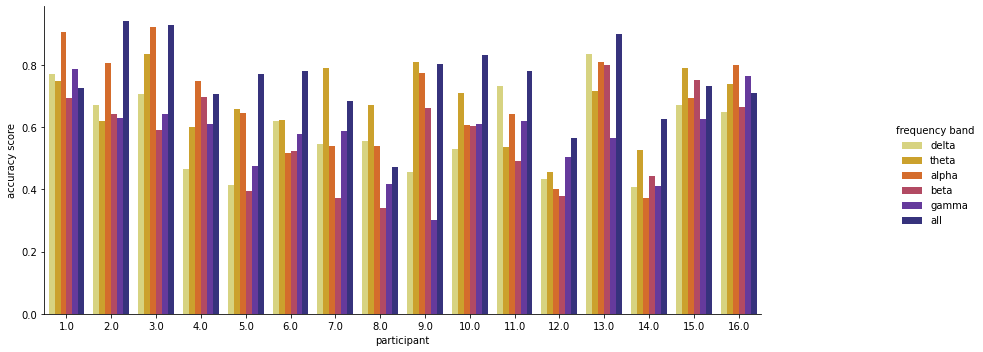

In [69]:
# plt.figure(figsize = (20,20))
g = sns.catplot(x='participant', y='accuracy score', hue='frequency band',
                data=df_post_participant, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)

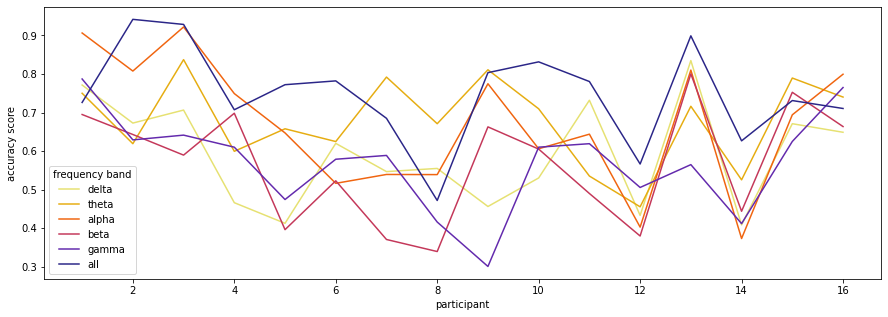

In [70]:
fig_dims = (15, 5)
fig, ax = plt.subplots(figsize=fig_dims)
sns.lineplot(x='participant', y='accuracy score', hue='frequency band',
                data=df_post_participant, palette = "CMRmap_r", ax = ax)

delta    0.591694
theta    0.677155
alpha    0.670720
beta     0.565892
gamma    0.570569
all      0.747738
dtype: float64


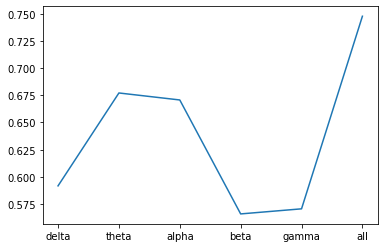

In [71]:
df_pd_post_participant.iloc[:, 1:].mean(axis = 0).plot()
print(df_pd_post_participant.iloc[:, 1:].mean(axis = 0))

## SESSION-INDEPENDENT

In [16]:
class sessionData:

    def __init__(self, frequency_band = 'all'):


        self.alldata , self.alllabel = create_file()
        self.number_participant = len(self.alldata)
        self.number_clips = len(self.alldata[0])
        self.frequency_band = frequency_band

       
        if self.frequency_band == 'all':
            pass
        
    
        elif self.frequency_band == 'delta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , : 62]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'theta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 62: 124]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'alpha':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 124: 186]
                    assert self.alldata[participant][clips].shape[1] == 62
        
        elif self.frequency_band == 'beta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 186: 248]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'gamma':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 248: 310]
                    assert self.alldata[participant][clips].shape[1] == 62
        else:
            raise ValueError("frequency band list: [delta, theta, alpha, beta, gamma, or all")
                

    def create_train_test(self, stack = False):
        # print(self.alldata[0][0].shape)
        # print(self.alllabel[0][0].shape)
        number_session = 3
        train_start_stop_1 = (0, 9)
        train_start_stop_2 = (15, 24)
        train_start_stop_3 = (30, 39)

        test_start_stop_1 = (10, 14)
        test_start_stop_2 = (25, 29)
        test_start_stop_3 = (40, 44)

        train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
        test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]


        Xtrain_data = [0,0,0]  
        Ytrain_data = [0,0,0]  

        Xtest_data = [0,0,0]
        ytest_data = [0,0,0]

         ## TRAIN DATA
        for session in range(number_session) :
            count = 0
            for participant in range(self.number_participant):
   
                for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtrain_data[session] = self.alldata[participant][clips]
                        Ytrain_data[session]  = self.alllabel[participant][clips]
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtrain_data[session].shape)
                        # print(Ytrain_data[session].shape)
                    else:
                        Xtrain_data[session] = np.vstack((Xtrain_data[session], self.alldata[participant][clips]))
                        Ytrain_data[session] = np.concatenate((Ytrain_data[session], self.alllabel[participant][clips]))
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtrain_data[session].shape)
                        # print(Ytrain_data[session].shape)

                # print(count)
                assert Xtrain_data[session].shape[0] == len(Ytrain_data[session])        

    

        ## TEST DATA
        for session in range(number_session) :
            count = 0
            for participant in range(self.number_participant):
   
                for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtest_data[session] = self.alldata[participant][clips]
                        ytest_data[session]  = self.alllabel[participant][clips]
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtest_data[session].shape)
                        # print(ytest_data[session].shape)
                    else:
                        Xtest_data[session] = np.vstack((Xtest_data[session], self.alldata[participant][clips]))
                        ytest_data[session] = np.concatenate((ytest_data[session], self.alllabel[participant][clips]))
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtest_data[session].shape)
                        # print(ytest_data[session].shape)

                # print(count)
                assert Xtest_data[session].shape[0] == len(ytest_data[session])   


        return  Xtrain_data, Xtest_data, Ytrain_data, ytest_data


        

###SVM model

In [ ]:
delta_svm_dataset2 = sessionData(frequency_band= 'delta')
X_train, X_test, y_train, y_test  = delta_svm_dataset2.create_train_test()


In [ ]:
for session in range(3):
    print(f"Here is the shape of each train-test dataset for {session+1} session...")
    print(X_train[session].shape)
    print(X_test[session].shape)
    print(y_train[session].shape)
    print(y_test[session].shape)
    print()

Here is the shape of each train-test dataset for 1 session...
(7024, 62)
(3872, 62)
(7024,)
(3872,)

Here is the shape of each train-test dataset for 2 session...
(5920, 62)
(2736, 62)
(5920,)
(2736,)

Here is the shape of each train-test dataset for 3 session...
(6240, 62)
(3376, 62)
(6240,)
(3376,)



#### Delta band

In [ ]:
session_delta_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_delta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of delta band of all 3 session: {np.mean(session_delta_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.38507231404958675
Accuracy of the 1 session: 0.5391081871345029
Accuracy of the 2 session: 0.45941943127962087

accuracy of delta band of all 3 session: 0.4611999774879035


In [ ]:
np.array(session_all_SVM_partipation_accuracy).reshape(-1, 1)

array([[0.49380165],
       [0.65277778],
       [0.51866114]])

#### Theta band

In [ ]:
theta_svm_dataset2 = sessionData(frequency_band= 'theta')
X_train, X_test, y_train, y_test  = theta_svm_dataset2.create_train_test()

session_theta_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_theta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of theta band of all 3 session: {np.mean(session_theta_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.3897210743801653
Accuracy of the 1 session: 0.45321637426900585
Accuracy of the 2 session: 0.4540876777251185

accuracy of theta band of all 3 session: 0.4323417087914299


#### Alpha band

In [ ]:
alpha_svm_dataset2 = sessionData(frequency_band= 'alpha')
X_train, X_test, y_train, y_test  = alpha_svm_dataset2.create_train_test()

session_alpha_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_alpha_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of alpha band of all 3 session: {np.mean(session_alpha_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.40547520661157027
Accuracy of the 1 session: 0.4071637426900585
Accuracy of the 2 session: 0.49881516587677727

accuracy of alpha band of all 3 session: 0.43715137172613533


#### Beta band

In [ ]:
beta_svm_dataset2 = sessionData(frequency_band= 'beta')
X_train, X_test, y_train, y_test  = beta_svm_dataset2.create_train_test()

session_beta_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_beta_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of beta band of all 3 session: {np.mean(session_beta_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.42665289256198347
Accuracy of the 1 session: 0.45358187134502925
Accuracy of the 2 session: 0.4037322274881517

accuracy of beta band of all 3 session: 0.42798899713172145


#### Gamma band

In [ ]:
gamma_svm_dataset2 = sessionData(frequency_band= 'gamma')
X_train, X_test, y_train, y_test  = gamma_svm_dataset2.create_train_test()

session_gamma_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_gamma_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of gamma band of all 3 session: {np.mean(session_gamma_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.44705578512396693
Accuracy of the 1 session: 0.3965643274853801
Accuracy of the 2 session: 0.4603080568720379

accuracy of gamma band of all 3 session: 0.43464272316046165


#### All bands

In [ ]:
all_svm_dataset2 = sessionData(frequency_band= 'all')
X_train, X_test, y_train, y_test  = all_svm_dataset2.create_train_test()

session_all_SVM_partipation_accuracy = []

for session in range(3):

    model = SVC(C= 50, kernel = 'rbf', degree= 3)
    model.fit(X_train[session], y_train[session])
    yhat = model.predict(X_test[session])
    score = accuracy_score(y_true = y_test[session], y_pred = yhat)
    session_all_SVM_partipation_accuracy.append(score)
    
    print(f'Accuracy of the {session} session: {score}')

print()
print(f"accuracy of all bands of all 3 session: {np.mean(session_all_SVM_partipation_accuracy)}")

Accuracy of the 0 session: 0.493801652892562
Accuracy of the 1 session: 0.6527777777777778
Accuracy of the 2 session: 0.5186611374407583

accuracy of all bands of all 3 session: 0.555080189370366


#### Plot suummary

In [ ]:
np.vstack(((np.arange(1,4, dtype = int)), session_delta_SVM_partipation_accuracy, session_theta_SVM_partipation_accuracy,
           session_alpha_SVM_partipation_accuracy, session_beta_SVM_partipation_accuracy,
           session_gamma_SVM_partipation_accuracy, session_all_SVM_partipation_accuracy)).T.shape

(3, 7)

In [ ]:
np.vstack(((np.arange(1,4, dtype = int)), session_delta_SVM_partipation_accuracy, session_theta_SVM_partipation_accuracy,
           session_alpha_SVM_partipation_accuracy, session_beta_SVM_partipation_accuracy,
           session_gamma_SVM_partipation_accuracy, session_all_SVM_partipation_accuracy)).T

array([[1.        , 0.38507231, 0.38972107, 0.40547521, 0.42665289,
        0.44705579, 0.49380165],
       [2.        , 0.53910819, 0.45321637, 0.40716374, 0.45358187,
        0.39656433, 0.65277778],
       [3.        , 0.45941943, 0.45408768, 0.49881517, 0.40373223,
        0.46030806, 0.51866114]])

In [ ]:
columns = ['session', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
session_svm_df = pd.DataFrame(data =np.vstack(((np.arange(1,4, dtype = int)), session_delta_SVM_partipation_accuracy, session_theta_SVM_partipation_accuracy,
           session_alpha_SVM_partipation_accuracy, session_beta_SVM_partipation_accuracy,
           session_gamma_SVM_partipation_accuracy, session_all_SVM_partipation_accuracy)).T, columns = columns)
session_svm_df

,session,delta,theta,alpha,beta,gamma,all
0,1.0,0.385072,0.389721,0.405475,0.426653,0.447056,0.493802
1,2.0,0.539108,0.453216,0.407164,0.453582,0.396564,0.652778
2,3.0,0.459419,0.454088,0.498815,0.403732,0.460308,0.518661


In [ ]:
session_svm_df_melted = pd.melt(session_svm_df, id_vars=['session'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
session_svm_df_melted

,session,frequency band,accuracy score
0,1.0,delta,0.385072
1,2.0,delta,0.539108
2,3.0,delta,0.459419
3,1.0,theta,0.389721
4,2.0,theta,0.453216
5,3.0,theta,0.454088
6,1.0,alpha,0.405475
7,2.0,alpha,0.407164
8,3.0,alpha,0.498815
9,1.0,beta,0.426653


In [ ]:
session_svm_df_melted.mean(axis =0)['accuracy score'] + session_svm_df_melted.std(axis =0)['accuracy score'] 

0.5242022445654841

([<matplotlib.axis.XTick at 0x7f3ccf403e10>,
 [Text(0, 0, '1'), Text(1, 0, '2'), Text(2, 0, '3')])

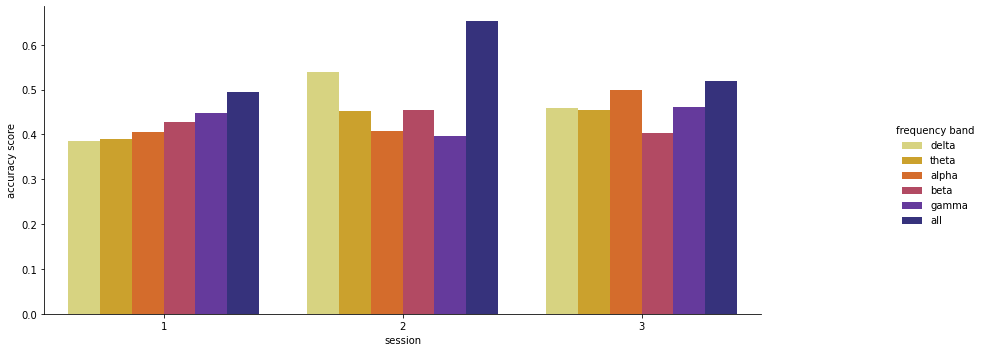

In [ ]:
g = sns.catplot(x='session', y='accuracy score', hue='frequency band',
                data=session_svm_df_melted, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)
plt.xticks([0.0, 1.0, 2.0], [1,2,3])

delta    0.461200
theta    0.432342
alpha    0.437151
beta     0.427989
gamma    0.434643
all      0.555080
dtype: float64


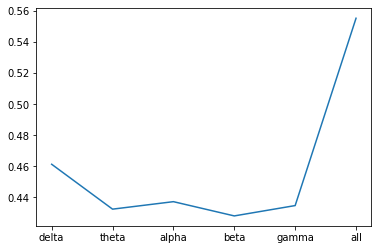

In [ ]:
np.mean(session_svm_df.iloc[: ,1:]).plot()
print(np.mean(session_svm_df.iloc[: ,1:]))
plt.show()

###Neural Network model

#### Pre-TensorBoard

**Session class**

In [80]:
class sessionData:

    def __init__(self, frequency_band = 'all'):


        self.alldata , self.alllabel = create_file()
        self.number_participant = len(self.alldata)
        self.number_clips = len(self.alldata[0])
        self.frequency_band = frequency_band

       
        if self.frequency_band == 'all':
            pass
        
    
        elif self.frequency_band == 'delta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , : 62]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'theta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 62: 124]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'alpha':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 124: 186]
                    assert self.alldata[participant][clips].shape[1] == 62
        
        elif self.frequency_band == 'beta':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 186: 248]
                    assert self.alldata[participant][clips].shape[1] == 62

        elif self.frequency_band == 'gamma':
            for participant in range(self.number_participant):
                for clips in range(self.number_clips):
                    self.alldata[participant][clips] = self.alldata[participant][clips][: , 248: 310]
                    assert self.alldata[participant][clips].shape[1] == 62
        else:
            raise ValueError("frequency band list: [delta, theta, alpha, beta, gamma, or all")
                

    def create_train_test(self, stack = False):
        # print(self.alldata[0][0].shape)
        # print(self.alllabel[0][0].shape)
        number_session = 3
        train_start_stop_1 = (0, 9)
        train_start_stop_2 = (15, 24)
        train_start_stop_3 = (30, 39)

        test_start_stop_1 = (10, 14)
        test_start_stop_2 = (25, 29)
        test_start_stop_3 = (40, 44)

        train_start_stop = [train_start_stop_1, train_start_stop_2,  train_start_stop_3]
        test_start_stop = [test_start_stop_1, test_start_stop_2,  test_start_stop_3]


        Xtrain_data = [0,0,0]  
        Ytrain_data = [0,0,0]  

        Xtest_data = [0,0,0]
        ytest_data = [0,0,0]

         ## TRAIN DATA
        for session in range(number_session) :
            count = 0
            for participant in range(self.number_participant):
   
                for clips in range(train_start_stop[session][0], train_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtrain_data[session] = self.alldata[participant][clips]
                        Ytrain_data[session]  = self.alllabel[participant][clips]
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtrain_data[session].shape)
                        # print(Ytrain_data[session].shape)
                    else:
                        Xtrain_data[session] = np.vstack((Xtrain_data[session], self.alldata[participant][clips]))
                        Ytrain_data[session] = np.concatenate((Ytrain_data[session], self.alllabel[participant][clips]))
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtrain_data[session].shape)
                        # print(Ytrain_data[session].shape)

                # print(count)
                assert Xtrain_data[session].shape[0] == len(Ytrain_data[session])        

    

        ## TEST DATA
        for session in range(number_session) :
            count = 0
            for participant in range(self.number_participant):
   
                for clips in range(test_start_stop[session][0], test_start_stop[session][1]+1 ):
                    
                    if count == 0:
                        Xtest_data[session] = self.alldata[participant][clips]
                        ytest_data[session]  = self.alllabel[participant][clips]
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtest_data[session].shape)
                        # print(ytest_data[session].shape)
                    else:
                        Xtest_data[session] = np.vstack((Xtest_data[session], self.alldata[participant][clips]))
                        ytest_data[session] = np.concatenate((ytest_data[session], self.alllabel[participant][clips]))
                        count += 1
                        # print(f"count: {count}, session: {session}, parti : {participant}, clips :{clips}")
                        # print(Xtest_data[session].shape)
                        # print(ytest_data[session].shape)

                # print(count)
                assert Xtest_data[session].shape[0] == len(ytest_data[session])   


        return  Xtrain_data, Xtest_data, Ytrain_data, ytest_data

**Hyperparameters for each band**

In [84]:
input_size = 62     
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

epochs = 500
batch_size = 256
learning_rate = 0.0001

##### Delta band

In [85]:
delta_session = sessionData(frequency_band= 'delta')
Xtrain_data_delta, Xtest_data_delta, Ytrain_data_delta, ytest_data_delta = delta_session.create_train_test()

In [86]:
session_list_delta = []
loss_session_delta_train_list = []

for session in range(3):
    session_acc_delta = []
    loss_session_delta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_delta[session]), torch.LongTensor(Ytrain_data_delta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_delta[session]), torch.LongTensor(ytest_data_delta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_delta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_delta.append(score)
            scores = statistics.mean(session_acc_delta)

    session_list_delta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_delta_train_list.append(loss_session_delta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.3883729272959184


Accuracy of the 2 session score: 0.3611653645833333


Accuracy of the 3 session score: 0.3784895833333333


##### Theta band

In [87]:
theta_session = sessionData(frequency_band= 'theta')
Xtrain_data_theta, Xtest_data_theta, Ytrain_data_theta, ytest_data_theta = theta_session.create_train_test()

In [88]:
session_list_theta = []
loss_session_theta_train_list = []

for session in range(3):
    session_acc_theta = []
    loss_session_theta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_theta[session]), torch.LongTensor(Ytrain_data_theta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_theta[session]), torch.LongTensor(ytest_data_theta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_session_theta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_theta.append(score)
            scores = statistics.mean(session_acc_theta)

    session_list_theta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_theta_train_list.append(loss_session_theta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.4211575255102041


Accuracy of the 2 session score: 0.3753255208333333


Accuracy of the 3 session score: 0.4678125


##### Alpha band

In [89]:
alpha_session = sessionData(frequency_band= 'alpha')
Xtrain_data_alpha, Xtest_data_alpha, Ytrain_data_alpha, ytest_data_alpha = alpha_session.create_train_test()

In [90]:
session_list_alpha = []
loss_session_alpha_train_list = []

for session in range(3):
    session_acc_alpha = []
    loss_session_alpha_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_alpha[session]), torch.LongTensor(Ytrain_data_alpha[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_alpha[session]), torch.LongTensor(ytest_data_alpha[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_alpha_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_alpha.append(score)
            scores = statistics.mean(session_acc_alpha)

    session_list_alpha.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_alpha_train_list.append(loss_session_alpha_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.4030213647959184


Accuracy of the 2 session score: 0.36474609375


Accuracy of the 3 session score: 0.41520833333333335


##### Beta band

In [91]:
beta_session = sessionData(frequency_band= 'beta')
Xtrain_data_beta, Xtest_data_beta, Ytrain_data_beta, ytest_data_beta = beta_session.create_train_test()

In [92]:
session_list_beta = []
loss_session_beta_train_list = []

for session in range(3):
    session_acc_beta = []
    loss_session_beta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_beta[session]), torch.LongTensor(Ytrain_data_beta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_beta[session]), torch.LongTensor(ytest_data_beta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_beta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_beta.append(score)
            scores = statistics.mean(session_acc_beta)

    session_list_beta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_beta_train_list.append(loss_session_beta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.3565648915816326


Accuracy of the 2 session score: 0.31640625


Accuracy of the 3 session score: 0.40317708333333335


##### Gamma band

In [93]:
gamma_session = sessionData(frequency_band= 'gamma')
Xtrain_data_gamma, Xtest_data_gamma, Ytrain_data_gamma, ytest_data_gamma = gamma_session.create_train_test()

In [94]:
session_list_gamma = []
loss_session_gamma_train_list = []

for session in range(3):
    session_acc_gamma = []
    loss_session_gamma_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_gamma[session]), torch.LongTensor(Ytrain_data_gamma[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_gamma[session]), torch.LongTensor(ytest_data_gamma[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_gamma_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_gamma.append(score)
            scores = statistics.mean(session_acc_gamma)

    session_list_gamma.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_gamma_train_list.append(loss_session_gamma_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.3592155612244898


Accuracy of the 2 session score: 0.3287760416666667


Accuracy of the 3 session score: 0.3963541666666667


##### All bands

**Hyperparameters for all bands**

In [95]:
input_size = 310      
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

epochs = 500
batch_size = 200
learning_rate = 0.0001

In [96]:
all_session = sessionData(frequency_band= 'all')
Xtrain_data_all, Xtest_data_all, Ytrain_data_all, ytest_data_all = all_session.create_train_test()

In [97]:
session_list_all = []
loss_session_all_train_list = []

for session in range(3):
    session_acc_all = []
    loss_session_all_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_all[session]), torch.LongTensor(Ytrain_data_all[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_all[session]), torch.LongTensor(ytest_data_all[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_all_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_all.append(score)
            scores = statistics.mean(session_acc_all)

    session_list_all.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_all_train_list.append(loss_session_all_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.40750000000000003


Accuracy of the 2 session score: 0.3918333333333333


Accuracy of the 3 session score: 0.4575


In [98]:
statistics.mean(session_list_all)

0.41894444444444445

#####Plot summary

In [99]:
columns = ['sessions', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
df_pd_pre_session = pd.DataFrame(data =np.vstack((np.arange(1,4, dtype= int), session_list_delta, session_list_theta,
           session_list_alpha, session_list_beta,
           session_list_gamma, session_list_all)).T, columns = columns)
df_pd_pre_session

,sessions,delta,theta,alpha,beta,gamma,all
0,1.0,0.388373,0.421158,0.403021,0.356565,0.359216,0.407500
1,2.0,0.361165,0.375326,0.364746,0.316406,0.328776,0.391833
2,3.0,0.378490,0.467813,0.415208,0.403177,0.396354,0.457500


In [100]:
df_pre_session = pd.melt(df_pd_pre_session, id_vars=['sessions'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
df_pre_session

,sessions,frequency band,accuracy score
0,1.0,delta,0.388373
1,2.0,delta,0.361165
2,3.0,delta,0.378490
3,1.0,theta,0.421158
4,2.0,theta,0.375326
5,3.0,theta,0.467813
6,1.0,alpha,0.403021
7,2.0,alpha,0.364746
8,3.0,alpha,0.415208
9,1.0,beta,0.356565


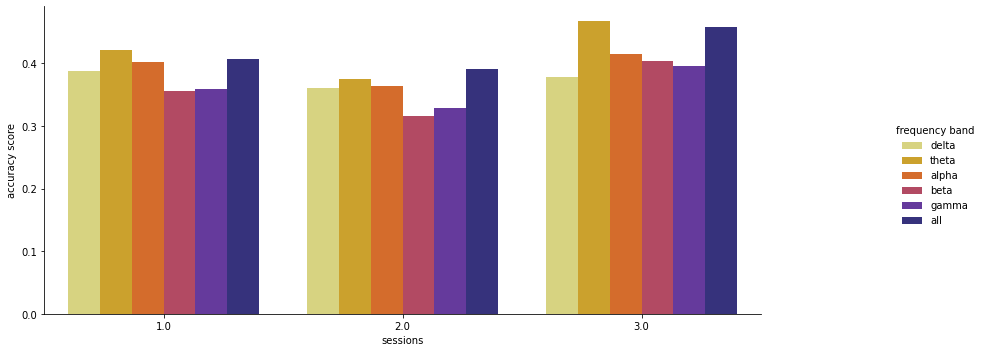

In [101]:
# plt.figure(figsize = (20,20))
g = sns.catplot(x='sessions', y='accuracy score', hue='frequency band',
                data=df_pre_session, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)

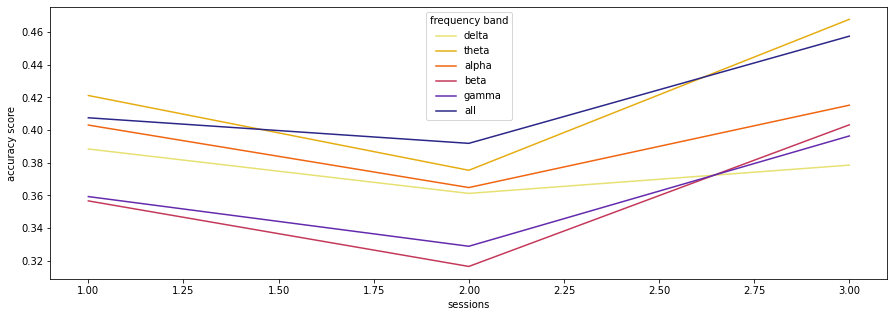

In [102]:
fig_dims = (15, 5)
fig, ax = plt.subplots(figsize=fig_dims)
sns.lineplot(x='sessions', y='accuracy score', hue='frequency band',
                data=df_pre_session, palette = "CMRmap_r", ax = ax)

delta    0.376009
theta    0.421432
alpha    0.394325
beta     0.358716
gamma    0.361449
all      0.418944
dtype: float64


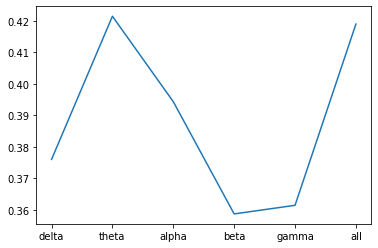

In [103]:
df_pd_pre_session.iloc[:, 1:].mean(axis = 0).plot()
print(df_pd_pre_session.iloc[:, 1:].mean(axis = 0))

#### TensorBoard

##### Finding best hyperparameters

**necessary parameters**

In [52]:
input_size = 310      
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5
epochs = 500
momentum = 0.9

**sampling hyperparameters**

In [54]:
batch_sizes = [128, 256, 512]
learning_rates = [0.001, 0.0001]

**Select 1 session to find hyperparameter**

In [55]:
session_acc_all = []
for batch_size in batch_sizes:
    for lr in learning_rates:
      start_time = time.time()

      train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_all[0]), torch.LongTensor(Ytrain_data_all[0]))
      test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_all[0]), torch.LongTensor(ytest_data_all[0]))
      train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
      test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

      model = Network().to(device)
      optimizer = optim.SGD(model.parameters(), lr=lr, momentum=momentum)         
      criterion = nn.CrossEntropyLoss()

      writer = SummaryWriter(f'/content/gdrive/MyDrive/logs/eeg_session/batch_size={batch_size}_lr={lr}_momentum={momentum}')
       
      step = 0  
      print(f"Hyper parameters : batch_size={batch_size}_lr={lr}_momentum={momentum}") 

      losses = [] 

      model.train()    
      loop = tqdm(range(epochs), leave=False)                            
      for epoch in loop:
        
        running_loss = 0.0
        
        for i, (data, labels) in enumerate(train_dataloader): 
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            running_loss += loss.item()
            losses.append(loss.item())

            # writer.add_histogram('fc3',model.fc3.weight,step)
            # print statistic eg. loss  
            writer.add_scalar('Training_Loss',loss,step)
            step += 1 

            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

      writer.add_hparams({'lr': lr, 'bsize': batch_size},{'hparam/loss': sum(losses)/len(losses)})

      model.eval()
      with torch.no_grad():
          correct = 0
          total   = 0
          for data, labels in test_dataloader:
              data = data.to(device)
              labels = labels.to(device) 
              outputs = model(data)      
              # out prediction
              final_output = (torch.max(outputs.data, 1)[1])
              score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
              session_acc_all.append(score)
              scores = statistics.mean(session_acc_all)

      end_time = time.time() - start_time
      print(f'End time : {end_time}')
      model.apply(parameters_reset)

writer.close()
print("Training Done !")

Hyper parameters : batch_size=128_lr=0.001_momentum=0.9


End time : 162.28098440170288
Hyper parameters : batch_size=128_lr=0.0001_momentum=0.9


End time : 160.43427729606628
Hyper parameters : batch_size=256_lr=0.001_momentum=0.9


End time : 94.14317011833191
Hyper parameters : batch_size=256_lr=0.0001_momentum=0.9


End time : 94.40601348876953
Hyper parameters : batch_size=512_lr=0.001_momentum=0.9


End time : 57.20431303977966
Hyper parameters : batch_size=512_lr=0.0001_momentum=0.9


End time : 56.690370082855225
Training Done !


##### TensorBoard

In [56]:
%reload_ext tensorboard

In [57]:
%tensorboard --logdir=/content/gdrive/MyDrive/logs/eeg_session/

Reusing TensorBoard on port 6006 (pid 1285), started 0:11:02 ago. (Use '!kill 1285' to kill it.)

<IPython.core.display.Javascript object>

In [39]:
train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_all[0]), torch.LongTensor(Ytrain_data_all[0]))
test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_all[0]), torch.LongTensor(ytest_data_all[0]))
train_dataloader = DataLoader(train_dataset, batch_size = 64, shuffle = False)
test_dataloader = DataLoader(train_dataset, batch_size = 64, shuffle =  False)

In [43]:
n = 0
for i, a in train_dataloader:
    # print(i.shape, a.shape)
    n += 1
print(n)

110


**Best hyperparameters**

In [58]:
epochs = 500
batch_size = 128
learning_rate = 0.0001

In [50]:
#delete tensorboardlog logs

# !rm -rf /content/gdrive/MyDrive/logs/eeg_session/

#### Post-TensorBoard

**Hyperparameters' session for each band**

In [61]:
input_size = 62     
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

###### Delta band

In [62]:
delta_session = sessionData(frequency_band= 'delta')
Xtrain_data_delta, Xtest_data_delta, Ytrain_data_delta, ytest_data_delta = delta_session.create_train_test()

In [63]:
session_list_delta = []
loss_session_delta_train_list = []

for session in range(3):
    session_acc_delta = []
    loss_session_delta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_delta[session]), torch.LongTensor(Ytrain_data_delta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_delta[session]), torch.LongTensor(ytest_data_delta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_delta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_delta.append(score)
            scores = statistics.mean(session_acc_delta)

    session_list_delta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_delta_train_list.append(loss_session_delta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.3827313311688312


Accuracy of the 2 session score: 0.36103723404255317


Accuracy of the 3 session score: 0.3956207482993197


##### Theta band

In [64]:
theta_session = sessionData(frequency_band= 'theta')
Xtrain_data_theta, Xtest_data_theta, Ytrain_data_theta, ytest_data_theta = theta_session.create_train_test()

In [65]:
session_list_theta = []
loss_session_theta_train_list = []

for session in range(3):
    session_acc_theta = []
    loss_session_theta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_theta[session]), torch.LongTensor(Ytrain_data_theta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_theta[session]), torch.LongTensor(ytest_data_theta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())

        loss_session_theta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_theta.append(score)
            scores = statistics.mean(session_acc_theta)

    session_list_theta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_theta_train_list.append(loss_session_theta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.4205154220779221


Accuracy of the 2 session score: 0.44498005319148937


Accuracy of the 3 session score: 0.4887329931972789


##### Alpha band

In [66]:
alpha_session = sessionData(frequency_band= 'alpha')
Xtrain_data_alpha, Xtest_data_alpha, Ytrain_data_alpha, ytest_data_alpha = alpha_session.create_train_test()

In [67]:
session_list_alpha = []
loss_session_alpha_train_list = []

for session in range(3):
    session_acc_alpha = []
    loss_session_alpha_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_alpha[session]), torch.LongTensor(Ytrain_data_alpha[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_alpha[session]), torch.LongTensor(ytest_data_alpha[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_alpha_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_alpha.append(score)
            scores = statistics.mean(session_acc_alpha)

    session_list_alpha.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_alpha_train_list.append(loss_session_alpha_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.44494724025974025


Accuracy of the 2 session score: 0.4148936170212766


Accuracy of the 3 session score: 0.46205357142857145


##### Beta band

In [68]:
beta_session = sessionData(frequency_band= 'beta')
Xtrain_data_beta, Xtest_data_beta, Ytrain_data_beta, ytest_data_beta = beta_session.create_train_test()

In [69]:
session_list_beta = []
loss_session_beta_train_list = []

for session in range(3):
    session_acc_beta = []
    loss_session_beta_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_beta[session]), torch.LongTensor(Ytrain_data_beta[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_beta[session]), torch.LongTensor(ytest_data_beta[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_beta_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_beta.append(score)
            scores = statistics.mean(session_acc_beta)

    session_list_beta.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_beta_train_list.append(loss_session_beta_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.36937905844155844


Accuracy of the 2 session score: 0.32613031914893614


Accuracy of the 3 session score: 0.38919005102040816


##### Gamma band

In [70]:
gamma_session = sessionData(frequency_band= 'gamma')
Xtrain_data_gamma, Xtest_data_gamma, Ytrain_data_gamma, ytest_data_gamma = gamma_session.create_train_test()

In [71]:
session_list_gamma = []
loss_session_gamma_train_list = []

for session in range(3):
    session_acc_gamma = []
    loss_session_gamma_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_gamma[session]), torch.LongTensor(Ytrain_data_gamma[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_gamma[session]), torch.LongTensor(ytest_data_gamma[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_gamma_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_gamma.append(score)
            scores = statistics.mean(session_acc_gamma)

    session_list_gamma.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_gamma_train_list.append(loss_session_gamma_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.3716517857142857


Accuracy of the 2 session score: 0.25482047872340424


Accuracy of the 3 session score: 0.4010416666666667


##### All bands

**Hyperparameters' session for all bands**

In [72]:
input_size = 310      
hidden_size_1 = 128
hidden_size_2 = 64  
output_size = 5

In [73]:
all_session = sessionData(frequency_band= 'all')
Xtrain_data_all, Xtest_data_all, Ytrain_data_all, ytest_data_all = all_session.create_train_test()

In [74]:
session_list_all = []
loss_session_all_train_list = []

for session in range(3):
    session_acc_all = []
    loss_session_all_train = []
    
    train_dataset = TensorDataset(torch.FloatTensor(Xtrain_data_all[session]), torch.LongTensor(Ytrain_data_all[session]))
    test_dataset = TensorDataset(torch.FloatTensor(Xtest_data_all[session]), torch.LongTensor(ytest_data_all[session]))
    train_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle = False)
    test_dataloader = DataLoader(train_dataset, batch_size = batch_size, shuffle =  False)

    model = Network().to(device)
    optimizer = optim.SGD(model.parameters(), lr=learning_rate, momentum =0.9)         
    criterion = nn.CrossEntropyLoss()

    loss_log = [] 
    model.train()                                
    loop = tqdm(range(epochs), leave=False)                            
    for epoch in loop:    
        for i, (data, labels) in enumerate(train_dataloader):
            data = data.to(device)
            labels = labels.to(device)   
            
            # Forward pass
            outputs = model(data)
            outputs = outputs.to(device)
            loss = criterion(outputs, labels)
            
            # Backward and optimize
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            # update progress bar
            loop.set_description(f'Epoch [{epoch}/{epochs}]')
            loop.set_postfix(loss = loss.item())
            
        loss_session_all_train.append(loss.item())

    model.eval()
    with torch.no_grad():
        correct = 0
        total   = 0
        for data, labels in test_dataloader:
            data = data.to(device)
            labels = labels.to(device)
            outputs = model(data)
        
            # out prediction
            final_output = (torch.max(outputs.data, 1)[1])

            score = accuracy_score(y_true = labels.cpu(), y_pred = final_output.cpu())
            session_acc_all.append(score)
            scores = statistics.mean(session_acc_all)

    session_list_all.append(scores)
    print(f'Accuracy of the {session+1} session score: {scores}')

    loss_session_all_train_list.append(loss_session_all_train)
    model.apply(parameters_reset)

Accuracy of the 1 session score: 0.43315746753246753


Accuracy of the 2 session score: 0.32978723404255317


Accuracy of the 3 session score: 0.2697172619047619


##### Plot summary

In [75]:
columns = ['sessions', 'delta', 'theta', 'alpha', 'beta', 'gamma', 'all']
df_pd_post_session = pd.DataFrame(data =np.vstack((np.arange(1,4, dtype= int), session_list_delta, session_list_theta,
           session_list_alpha, session_list_beta,
           session_list_gamma, session_list_all)).T, columns = columns)
df_pd_post_session

,sessions,delta,theta,alpha,beta,gamma,all
0,1.0,0.382731,0.420515,0.444947,0.369379,0.371652,0.433157
1,2.0,0.361037,0.444980,0.414894,0.326130,0.254820,0.329787
2,3.0,0.395621,0.488733,0.462054,0.389190,0.401042,0.269717


In [76]:
df_post_session = pd.melt(df_pd_post_session, id_vars=['sessions'],
             value_vars = ['delta', 'theta', 'alpha', 'beta', 'gamma', 'all'],
             var_name="frequency band", value_name="accuracy score")
df_post_session

,sessions,frequency band,accuracy score
0,1.0,delta,0.382731
1,2.0,delta,0.361037
2,3.0,delta,0.395621
3,1.0,theta,0.420515
4,2.0,theta,0.444980
5,3.0,theta,0.488733
6,1.0,alpha,0.444947
7,2.0,alpha,0.414894
8,3.0,alpha,0.462054
9,1.0,beta,0.369379


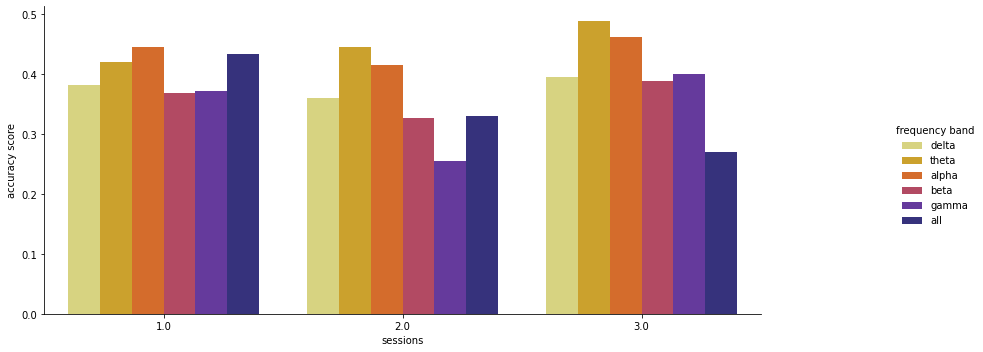

In [77]:
# plt.figure(figsize = (20,20))
g = sns.catplot(x='sessions', y='accuracy score', hue='frequency band',
                data=df_post_session, kind='bar', palette = "CMRmap_r")
g.fig.set_figwidth(15)
g.fig.set_figheight(5)

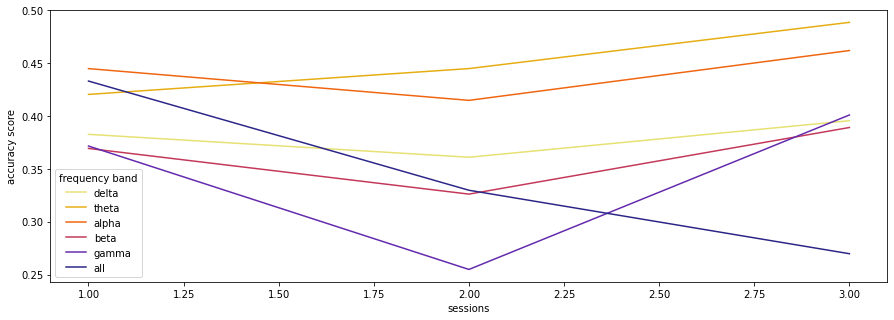

In [78]:
fig_dims = (15, 5)
fig, ax = plt.subplots(figsize=fig_dims)
sns.lineplot(x='sessions', y='accuracy score', hue='frequency band',
                data=df_post_session, palette = "CMRmap_r", ax = ax)

delta    0.379796
theta    0.451409
alpha    0.440631
beta     0.361566
gamma    0.342505
all      0.344221
dtype: float64


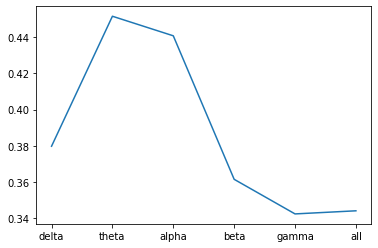

In [79]:
df_pd_post_session.iloc[:, 1:].mean(axis = 0).plot()
print(df_pd_post_session.iloc[:, 1:].mean(axis = 0))